# BGP vs mBGP timings

This is part of the UAI reviews. We want to check empirically how BGP vs mBGP scales as a function of output dimensions.


# Helper definitions

In [1]:
from MMBGP.data_generation import ToyBranchedData, GeneExpressionData
from MMBGP.training_helpers import TrainingOutcome, get_training_outcome, get_funky_phi, FunkyPrior
from MMBGP.plotting_helpers import plot_detailed_fit, plot_model_snapshot
from MMBGP.sampling_helpers import get_synthetic_noisy_branched_data

from MMBGP.assigngp import AssignGP
from MMBGP.VBHelperFunctions import plotBranchModel
import matplotlib.pyplot as plt
import numpy as np

from MMBGP.training_helpers import (
    construct_assigngp_model, 
    SimplePhiConstructor, 
    ScipyOptimiser, 
    ElvijsAmazingOptimiser,
    AssignGPOptimiser,
)
import gpflow
from typing import Sequence


def get_assigngp_with_target_bps(bps: Sequence[float], lengthscale: float, noise_variance: float) -> AssignGP:
    """ A simple wrapper that tweaks some key model construction parameters. """
    data = ToyBranchedData(bps, N=100)  # not used; need data to construct a model
    m = construct_assigngp_model(
        gene_expression=data,
        phi_constructor=SimplePhiConstructor(data, prior_confidence=0.65),
        initial_branching_points=[0.5]*data.num_genes,
    )
    
    # assign reasonable initial values for the BPs
    m.kernel.Bv.assign(np.array(bps))
    m.kernel.kern.lengthscales.assign(lengthscale)
    m.likelihood.variance.assign(noise_variance)
    return m

In [3]:
import numpy as np
import pandas as pd


from dataclasses import dataclass
from typing import List


@dataclass
class Result:
    data: GeneExpressionData  # the data we have attempted to fit models to
    true_bps: np.ndarray  # true branching points
    time_mmbgp_s: float
    mmbgp: AssignGP  # the trained MMBGP model for the provided data
    time_bgps_s: float
    bgps: Sequence[AssignGP]  # the trained BGP models for the provided data


def rmse(a: np.ndarray, b: np.ndarray) -> float:
    assert a.shape == b.shape
    n = a.shape[0]
    return np.sqrt(((a - b)**2).mean())


def convert_results_to_df(res: Sequence[Result]) -> pd.DataFrame:
    dictified_results = []
    
    for i, r in enumerate(res):
        dres = dict(
            sample_id=i,
            time_mmbgp_s=r.time_mmbgp_s,
            mmbgp_bp_rmse=rmse(r.true_bps, r.mmbgp.BranchingPoints),
            time_bgps_s=r.time_bgps_s,
            bgp_bp_rmse=rmse(r.true_bps, np.array([bgp.BranchingPoints[0] for bgp in r.bgps])),
        )
        
        dictified_results.append(dres)
    
    return pd.DataFrame(dictified_results)

10 samples drawn, 0 valid samples constructed
Processing synthetic data for 1 genes
Uninformative until idx: 800
MMBGP trained in 22.0 seconds


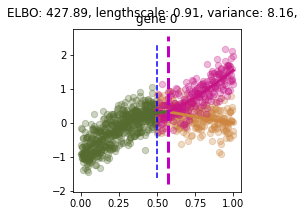

Slicing for gene 0
Uninformative until idx: 800


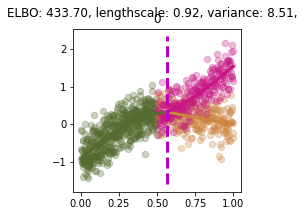

BGPs trained in 25.1 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 2 genes
Uninformative until idx: 800
MMBGP trained in 20.3 seconds


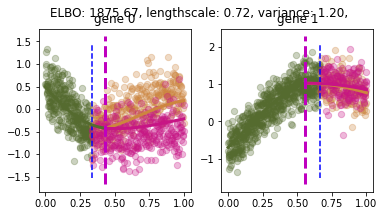

Slicing for gene 0
Uninformative until idx: 800


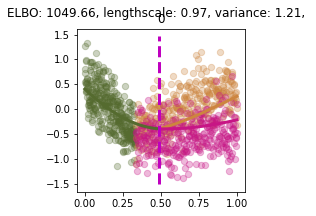

Slicing for gene 1
Uninformative until idx: 800


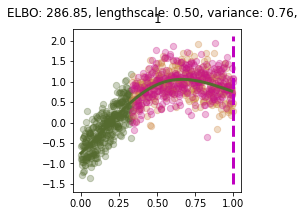

BGPs trained in 46.3 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 3 genes
Uninformative until idx: 800
MMBGP trained in 595.3 seconds


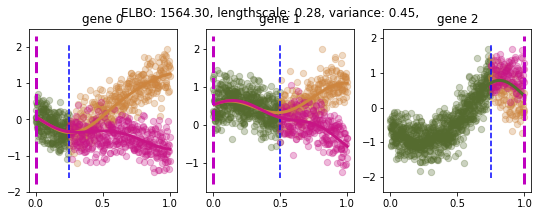

Slicing for gene 0
Uninformative until idx: 800


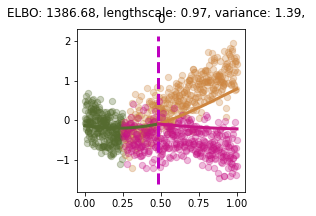

Slicing for gene 1
Uninformative until idx: 800


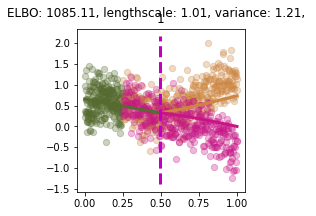

Slicing for gene 2
Uninformative until idx: 800


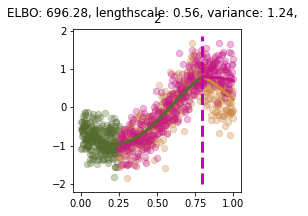

BGPs trained in 62.9 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 4 genes
Uninformative until idx: 800
MMBGP trained in 62.1 seconds


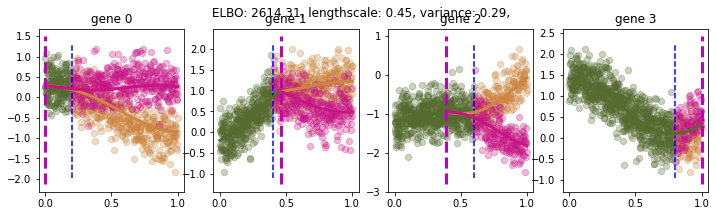

Slicing for gene 0
Uninformative until idx: 800


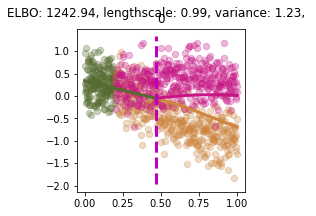

Slicing for gene 1
Uninformative until idx: 800


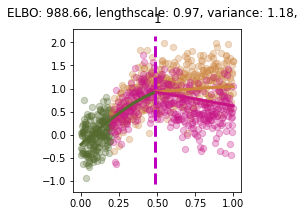

Slicing for gene 2
Uninformative until idx: 800


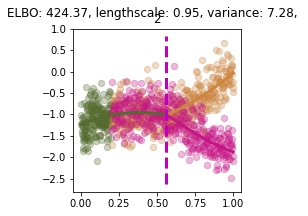

Slicing for gene 3
Uninformative until idx: 800


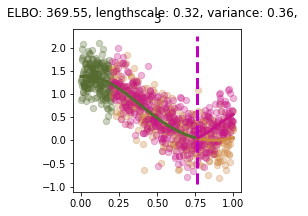

BGPs trained in 106.5 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 5 genes
Uninformative until idx: 800
MMBGP trained in 827.5 seconds


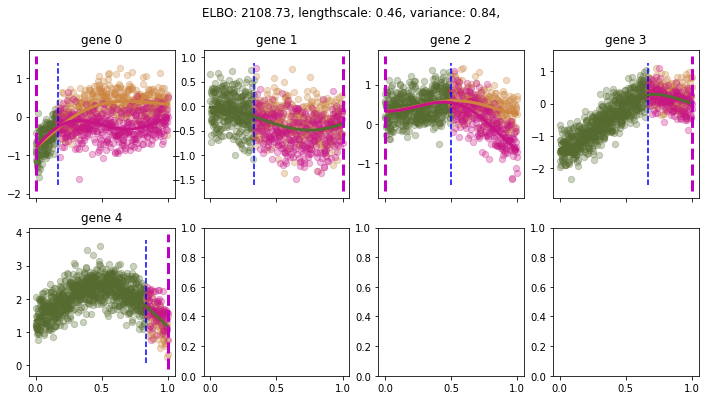

Slicing for gene 0
Uninformative until idx: 800


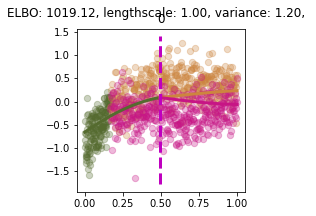

Slicing for gene 1
Uninformative until idx: 800


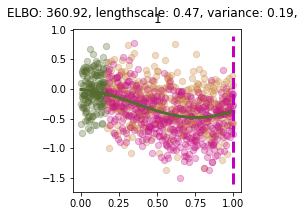

Slicing for gene 2
Uninformative until idx: 800


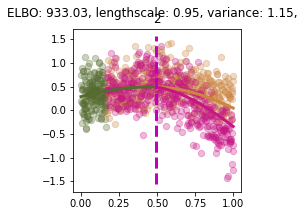

Slicing for gene 3
Uninformative until idx: 800


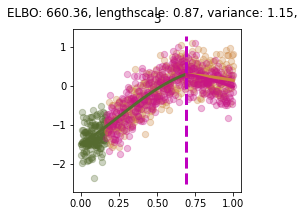

Slicing for gene 4
Uninformative until idx: 800


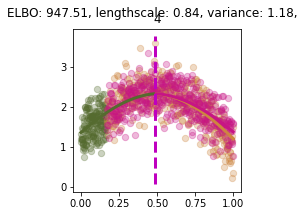

BGPs trained in 96.4 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 6 genes
Uninformative until idx: 800
MMBGP trained in 117.1 seconds


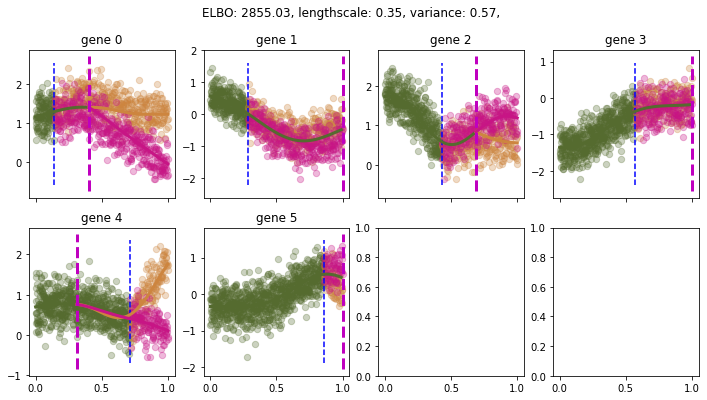

Slicing for gene 0
Uninformative until idx: 800


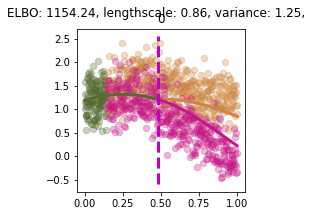

Slicing for gene 1
Uninformative until idx: 800


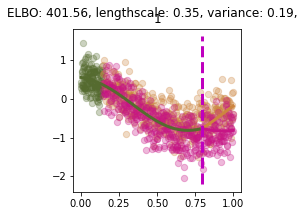

Slicing for gene 2
Uninformative until idx: 800


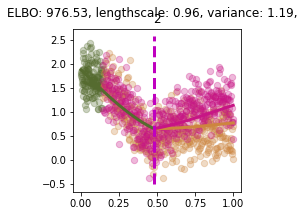

Slicing for gene 3
Uninformative until idx: 800


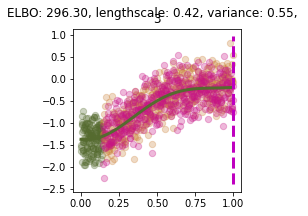

Slicing for gene 4
Uninformative until idx: 800


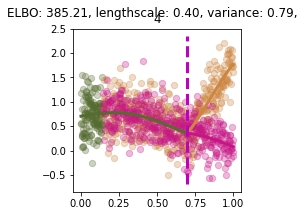

Slicing for gene 5
Uninformative until idx: 800


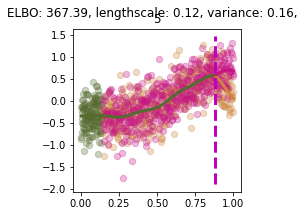

BGPs trained in 160.4 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 7 genes
Uninformative until idx: 800
MMBGP trained in 409.0 seconds


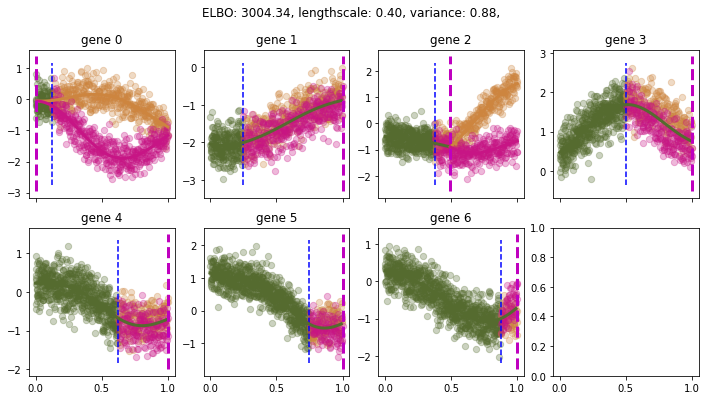

Slicing for gene 0
Uninformative until idx: 800


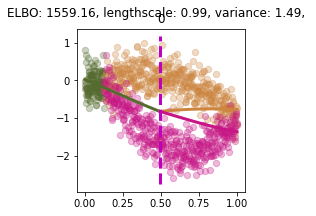

Slicing for gene 1
Uninformative until idx: 800


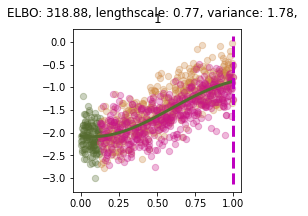

Slicing for gene 2
Uninformative until idx: 800


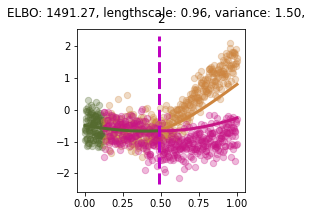

Slicing for gene 3
Uninformative until idx: 800


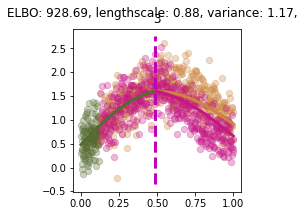

Slicing for gene 4
Uninformative until idx: 800


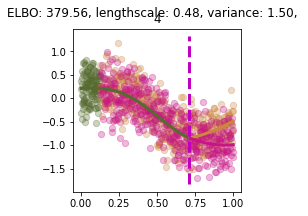

Slicing for gene 5
Uninformative until idx: 800


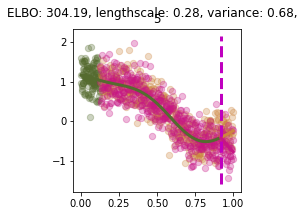

Slicing for gene 6
Uninformative until idx: 800


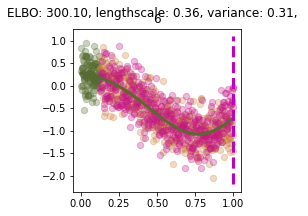

BGPs trained in 173.7 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 8 genes
Uninformative until idx: 800
MMBGP trained in 269.4 seconds


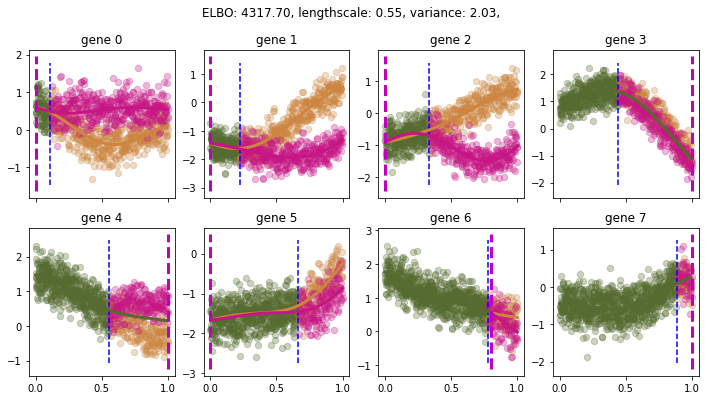

Slicing for gene 0
Uninformative until idx: 800


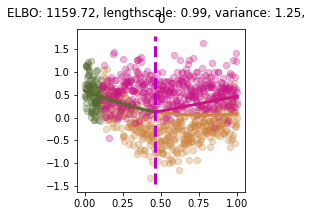

Slicing for gene 1
Uninformative until idx: 800


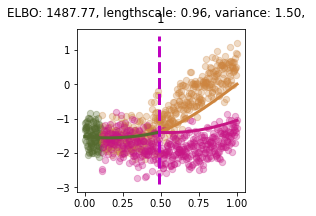

Slicing for gene 2
Uninformative until idx: 800


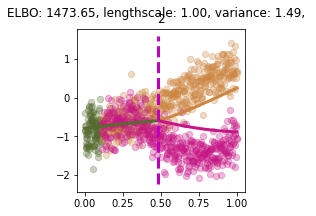

Slicing for gene 3
Uninformative until idx: 800


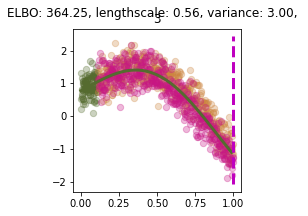

Slicing for gene 4
Uninformative until idx: 800


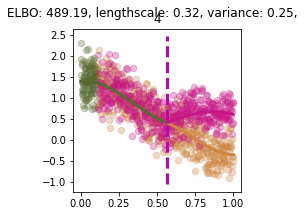

Slicing for gene 5
Uninformative until idx: 800


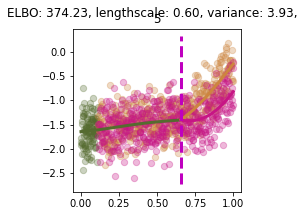

Slicing for gene 6
Uninformative until idx: 800


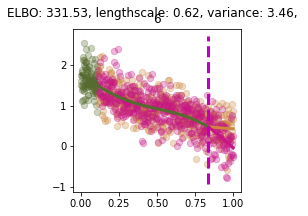

Slicing for gene 7
Uninformative until idx: 800


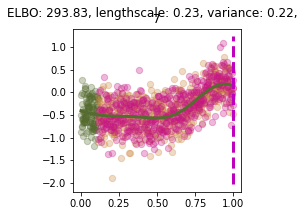

BGPs trained in 211.8 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 9 genes
Uninformative until idx: 800
MMBGP trained in 165.8 seconds


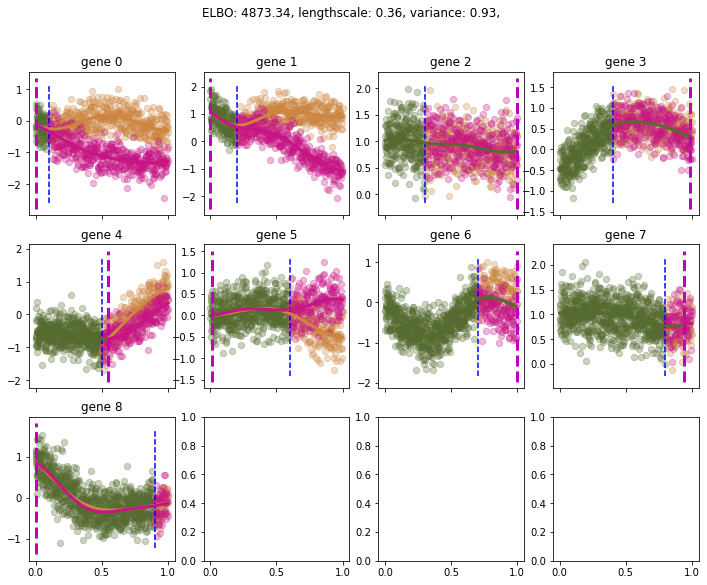

Slicing for gene 0
Uninformative until idx: 800


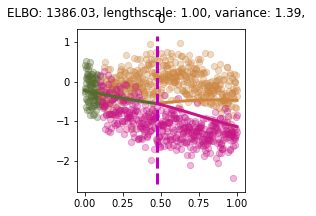

Slicing for gene 1
Uninformative until idx: 800


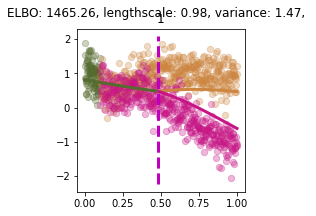

Slicing for gene 2
Uninformative until idx: 800


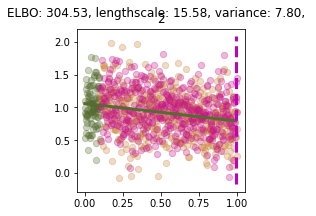

Slicing for gene 3
Uninformative until idx: 800


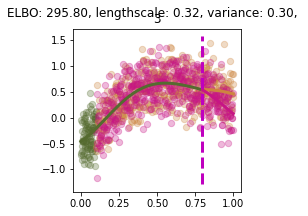

Slicing for gene 4
Uninformative until idx: 800


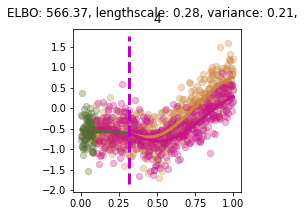

Slicing for gene 5
Uninformative until idx: 800


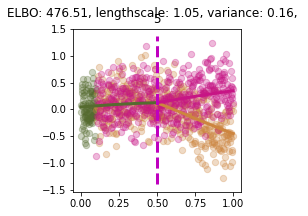

Slicing for gene 6
Uninformative until idx: 800


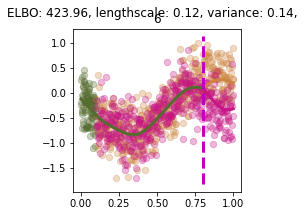

Slicing for gene 7
Uninformative until idx: 800


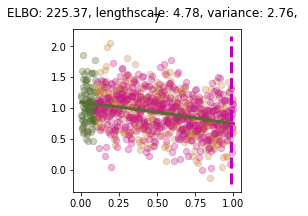

Slicing for gene 8
Uninformative until idx: 800


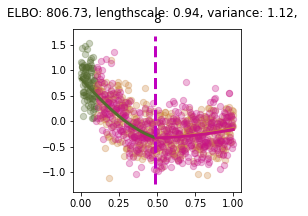

BGPs trained in 231.1 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 10 genes
Uninformative until idx: 800
MMBGP trained in 277.1 seconds


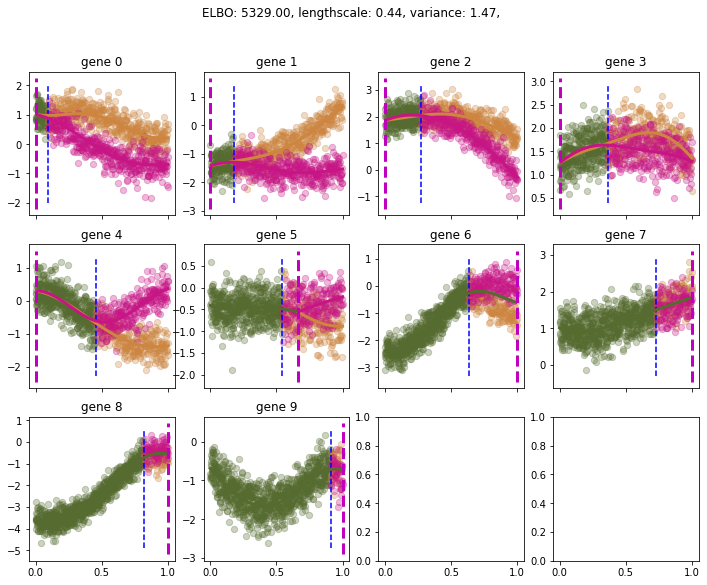

Slicing for gene 0
Uninformative until idx: 800


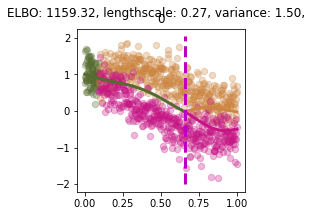

Slicing for gene 1
Uninformative until idx: 800


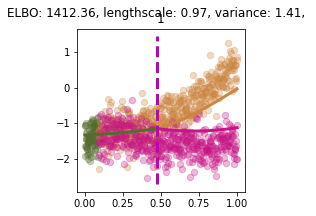

Slicing for gene 2
Uninformative until idx: 800


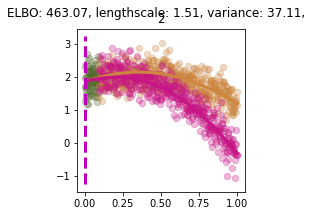

Slicing for gene 3
Uninformative until idx: 800


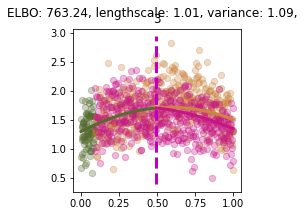

Slicing for gene 4
Uninformative until idx: 800


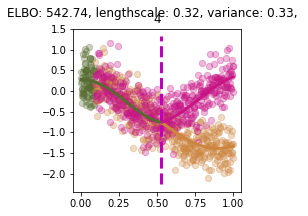

Slicing for gene 5
Uninformative until idx: 800


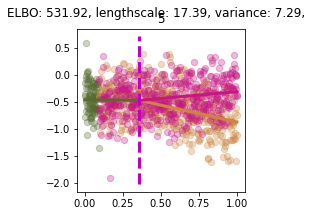

Slicing for gene 6
Uninformative until idx: 800


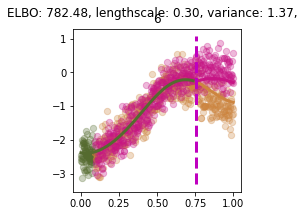

Slicing for gene 7
Uninformative until idx: 800


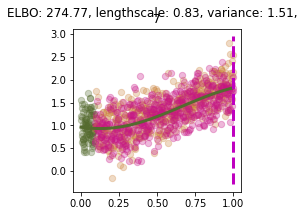

Slicing for gene 8
Uninformative until idx: 800


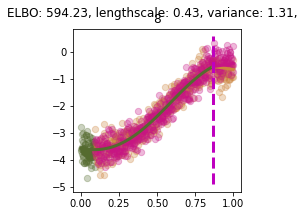

Slicing for gene 9
Uninformative until idx: 800


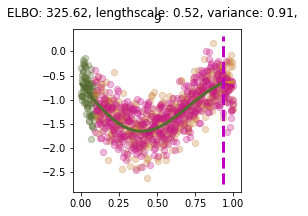

BGPs trained in 566.2 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 11 genes
Uninformative until idx: 800
MMBGP trained in 1776.2 seconds


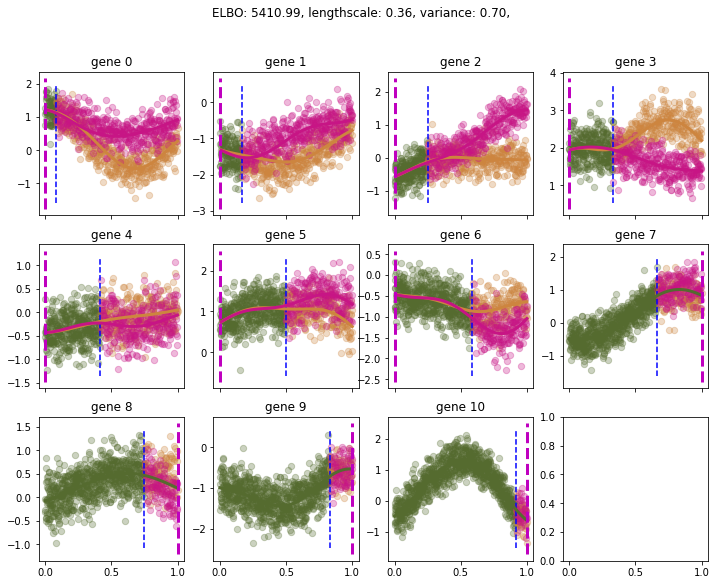

Slicing for gene 0
Uninformative until idx: 800


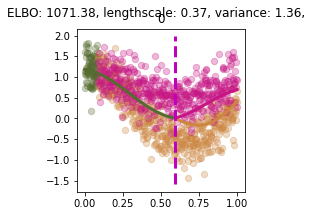

Slicing for gene 1
Uninformative until idx: 800


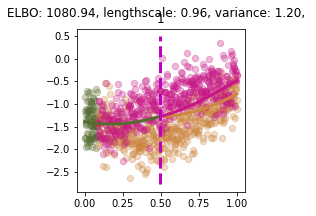

Slicing for gene 2
Uninformative until idx: 800


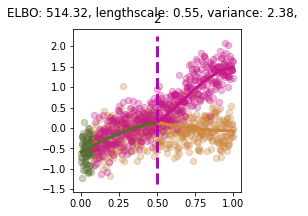

Slicing for gene 3
Uninformative until idx: 800


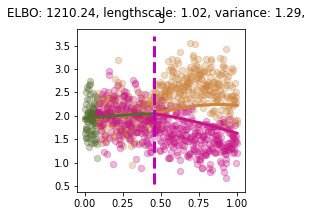

Slicing for gene 4
Uninformative until idx: 800


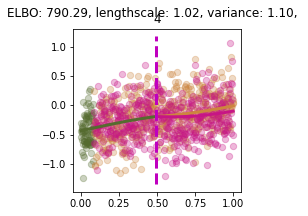

Slicing for gene 5
Uninformative until idx: 800


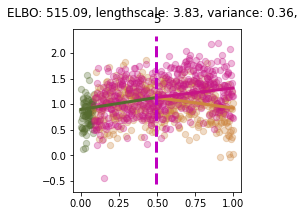

Slicing for gene 6
Uninformative until idx: 800


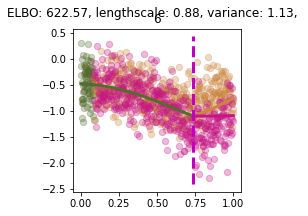

Slicing for gene 7
Uninformative until idx: 800


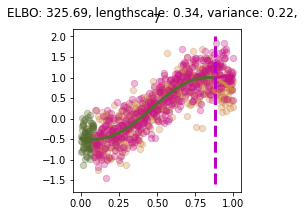

Slicing for gene 8
Uninformative until idx: 800


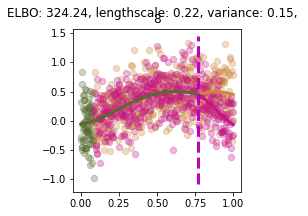

Slicing for gene 9
Uninformative until idx: 800


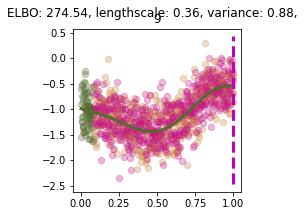

Slicing for gene 10
Uninformative until idx: 800


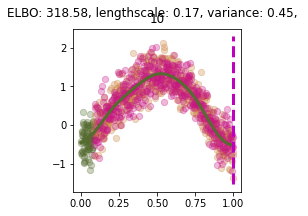

BGPs trained in 275.3 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 12 genes
Uninformative until idx: 800
MMBGP trained in 416.7 seconds


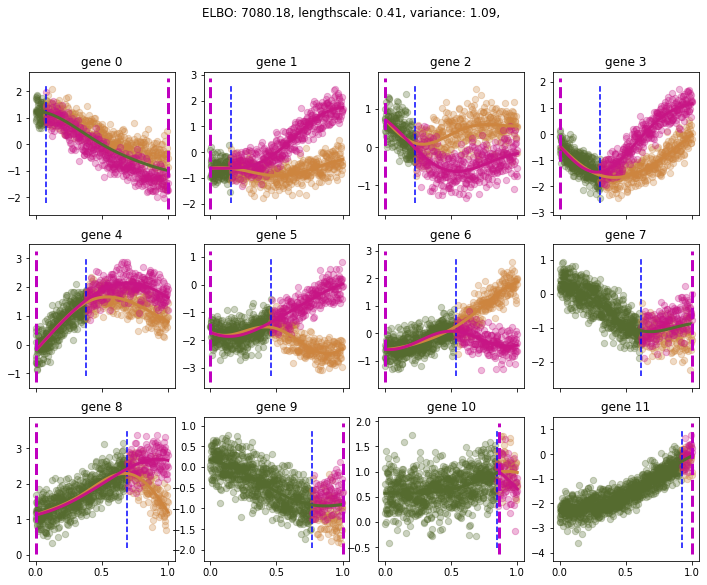

Slicing for gene 0
Uninformative until idx: 800


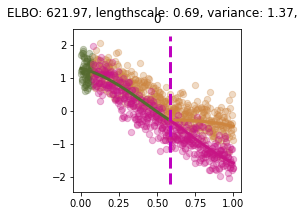

Slicing for gene 1
Uninformative until idx: 800


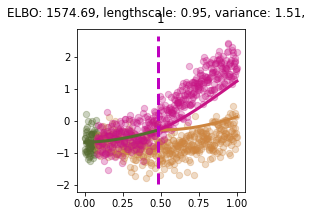

Slicing for gene 2
Uninformative until idx: 800


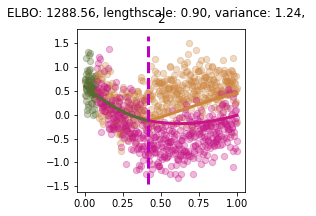

Slicing for gene 3
Uninformative until idx: 800


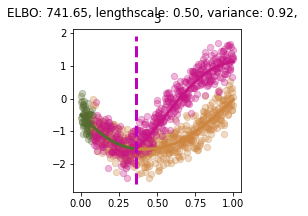

Slicing for gene 4
Uninformative until idx: 800


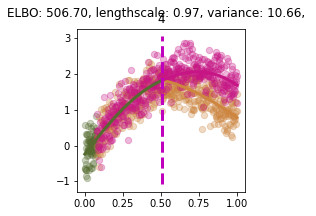

Slicing for gene 5
Uninformative until idx: 800


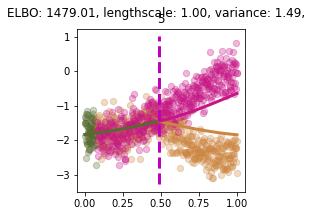

Slicing for gene 6
Uninformative until idx: 800


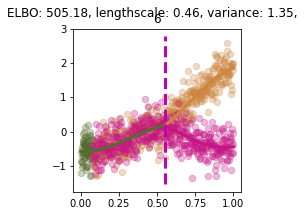

Slicing for gene 7
Uninformative until idx: 800


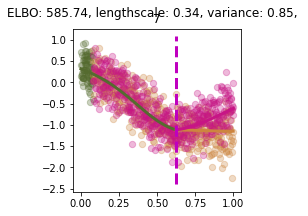

Slicing for gene 8
Uninformative until idx: 800


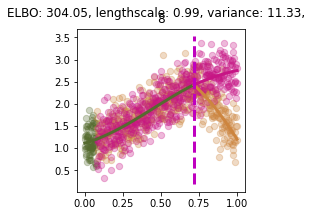

Slicing for gene 9
Uninformative until idx: 800


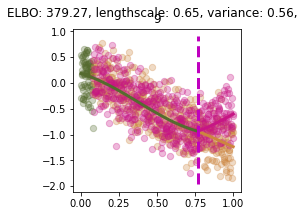

Slicing for gene 10
Uninformative until idx: 800


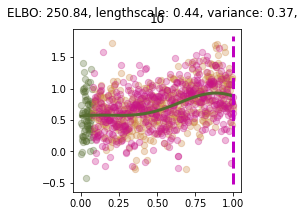

Slicing for gene 11
Uninformative until idx: 800


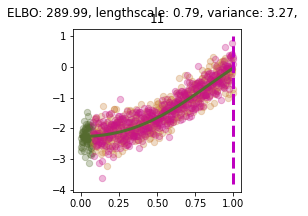

BGPs trained in 332.4 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 13 genes
Uninformative until idx: 800
MMBGP trained in 367.3 seconds


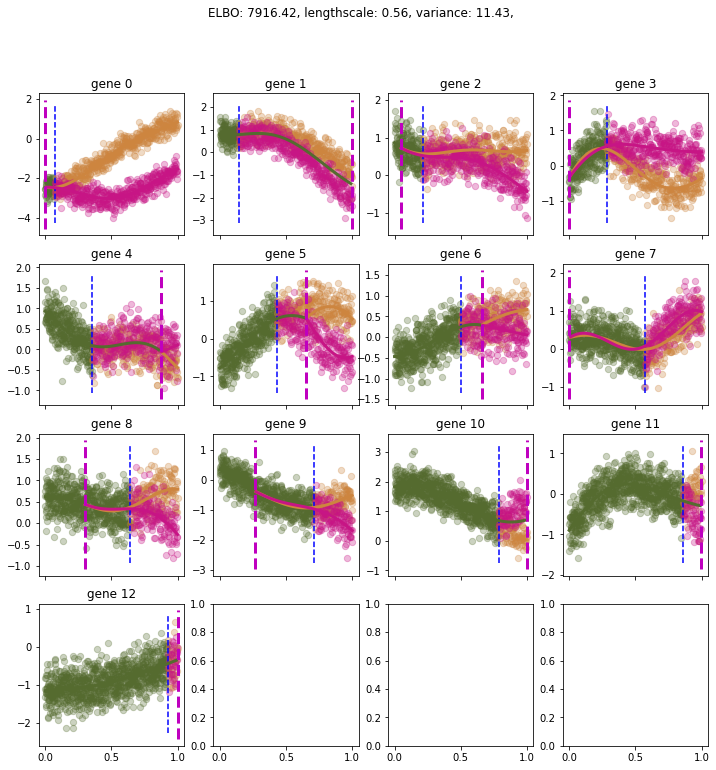

Slicing for gene 0
Uninformative until idx: 800


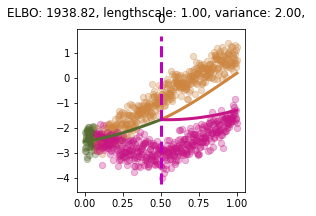

Slicing for gene 1
Uninformative until idx: 800


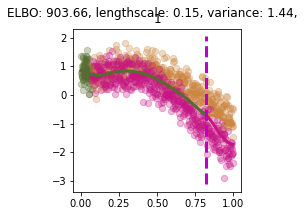

Slicing for gene 2
Uninformative until idx: 800


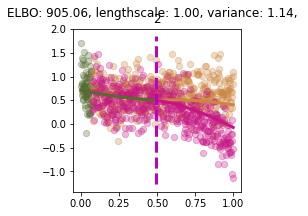

Slicing for gene 3
Uninformative until idx: 800


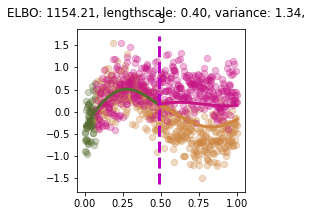

Slicing for gene 4
Uninformative until idx: 800


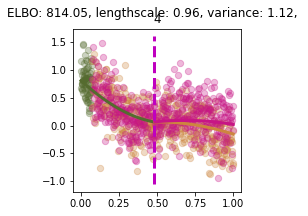

Slicing for gene 5
Uninformative until idx: 800


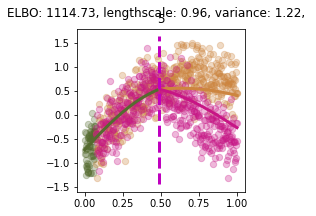

Slicing for gene 6
Uninformative until idx: 800


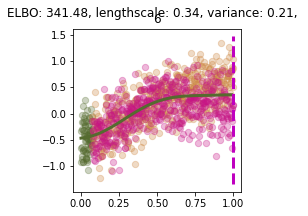

Slicing for gene 7
Uninformative until idx: 800


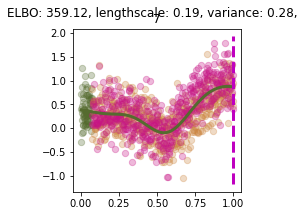

Slicing for gene 8
Uninformative until idx: 800


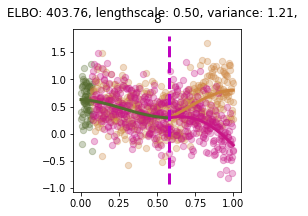

Slicing for gene 9
Uninformative until idx: 800


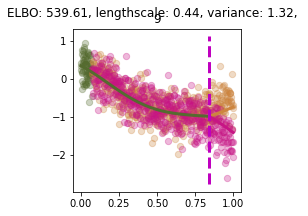

Slicing for gene 10
Uninformative until idx: 800


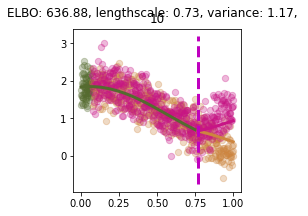

Slicing for gene 11
Uninformative until idx: 800


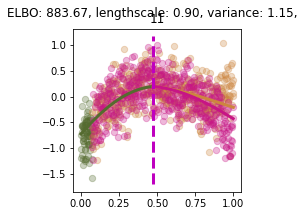

Slicing for gene 12
Uninformative until idx: 800


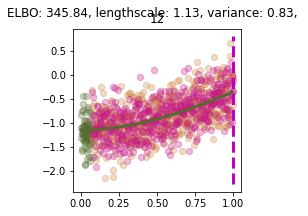

BGPs trained in 297.7 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 14 genes
Uninformative until idx: 800
MMBGP trained in 362.6 seconds


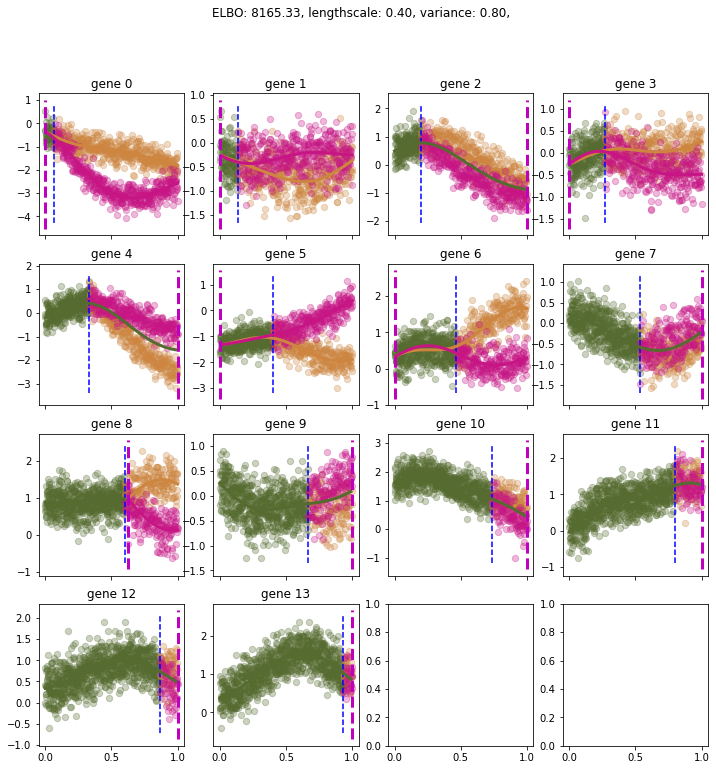

Slicing for gene 0
Uninformative until idx: 800


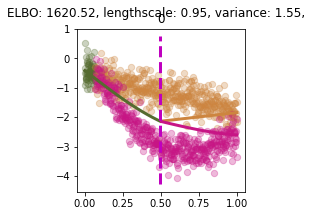

Slicing for gene 1
Uninformative until idx: 800


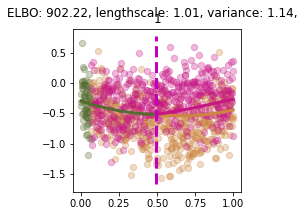

Slicing for gene 2
Uninformative until idx: 800


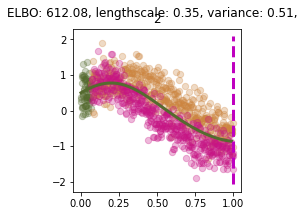

Slicing for gene 3
Uninformative until idx: 800


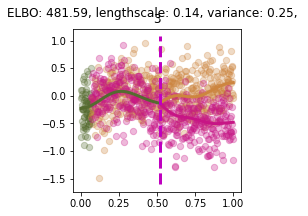

Slicing for gene 4
Uninformative until idx: 800


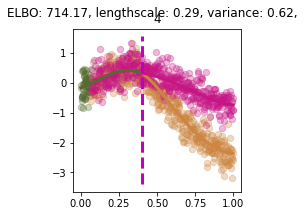

Slicing for gene 5
Uninformative until idx: 800


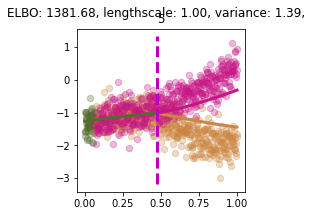

Slicing for gene 6
Uninformative until idx: 800


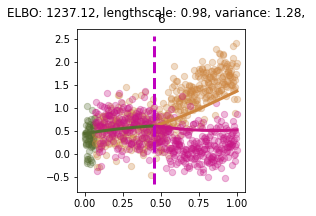

Slicing for gene 7
Uninformative until idx: 800


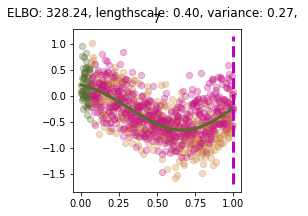

Slicing for gene 8
Uninformative until idx: 800


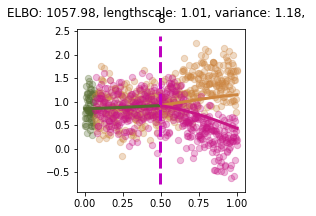

Slicing for gene 9
Uninformative until idx: 800


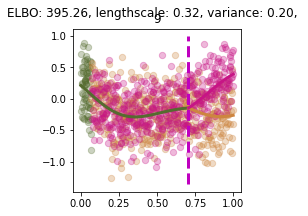

Slicing for gene 10
Uninformative until idx: 800


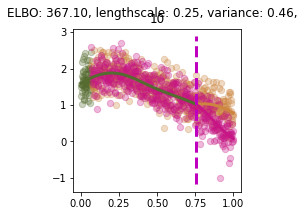

Slicing for gene 11
Uninformative until idx: 800


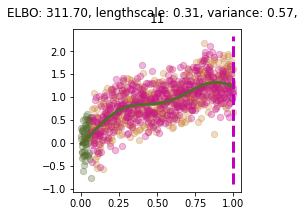

Slicing for gene 12
Uninformative until idx: 800


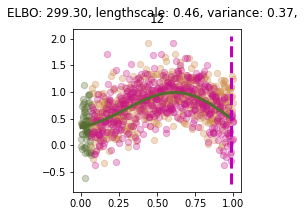

Slicing for gene 13
Uninformative until idx: 800


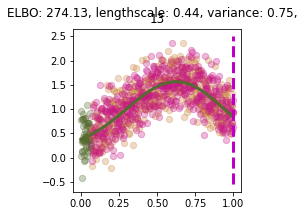

BGPs trained in 394.8 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 15 genes
Uninformative until idx: 800
MMBGP trained in 408.1 seconds


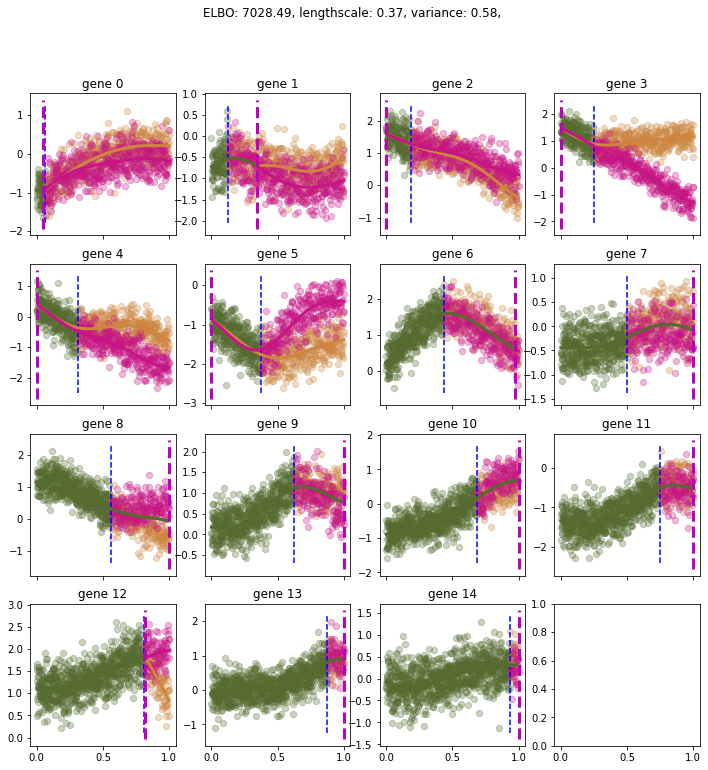

Slicing for gene 0
Uninformative until idx: 800


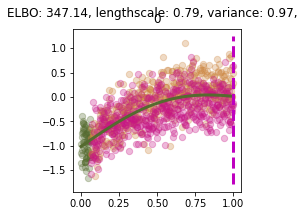

Slicing for gene 1
Uninformative until idx: 800


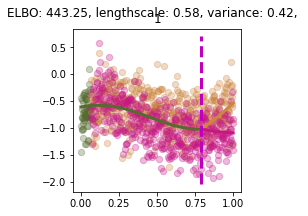

Slicing for gene 2
Uninformative until idx: 800


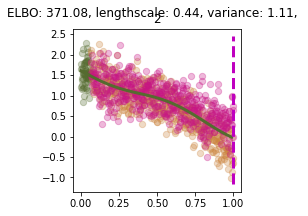

Slicing for gene 3
Uninformative until idx: 800


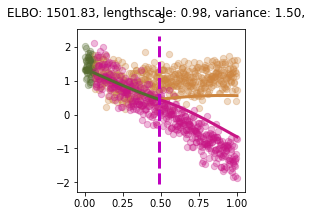

Slicing for gene 4
Uninformative until idx: 800


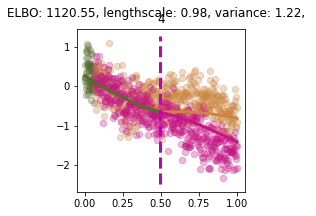

Slicing for gene 5
Uninformative until idx: 800


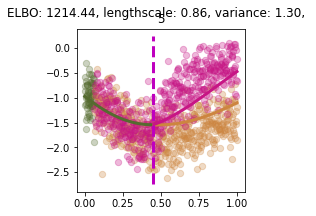

Slicing for gene 6
Uninformative until idx: 800


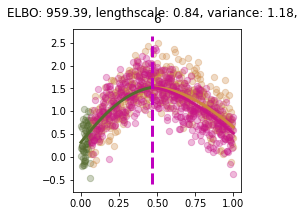

Slicing for gene 7
Uninformative until idx: 800


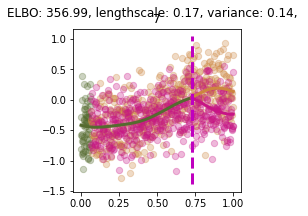

Slicing for gene 8
Uninformative until idx: 800


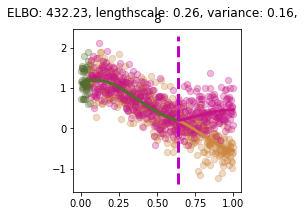

Slicing for gene 9
Uninformative until idx: 800


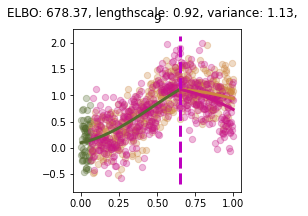

Slicing for gene 10
Uninformative until idx: 800


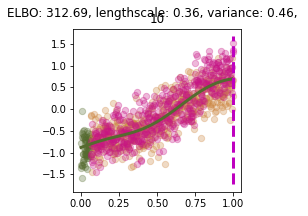

Slicing for gene 11
Uninformative until idx: 800


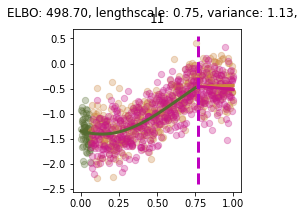

Slicing for gene 12
Uninformative until idx: 800


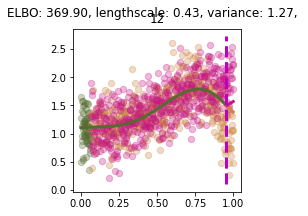

Slicing for gene 13
Uninformative until idx: 800


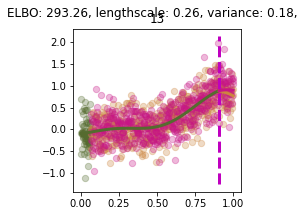

Slicing for gene 14
Uninformative until idx: 800


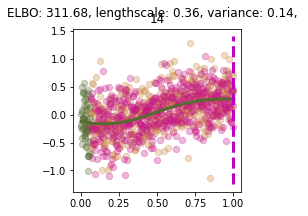

BGPs trained in 379.3 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 16 genes
Uninformative until idx: 800
Error in training:  Input matrix is not invertible.
	 [[node triangular_solve_29/MatrixTriangularSolve (defined at /Users/elvijssarkans/dev/MMBGP/MMBGP/assigngp.py:451) ]] [Op:__inference__tf_eval_5828327]

Errors may have originated from an input operation.
Input Source operations connected to node triangular_solve_29/MatrixTriangularSolve:
 MatMul_59 (defined at /Users/elvijssarkans/dev/MMBGP/MMBGP/assigngp.py:450)	
 Cholesky_29 (defined at /Users/elvijssarkans/dev/MMBGP/MMBGP/assigngp.py:449)

Function call stack:
_tf_eval



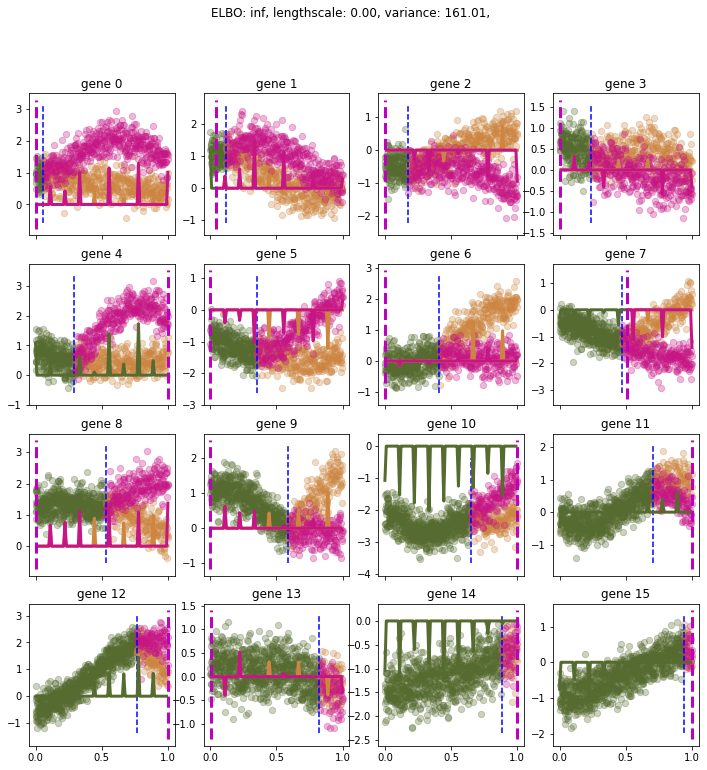

Slicing for gene 0
Uninformative until idx: 800


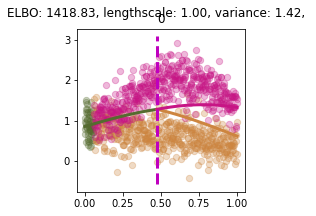

Slicing for gene 1
Uninformative until idx: 800


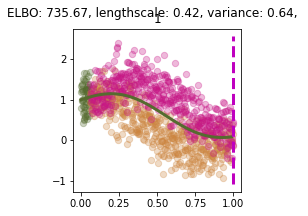

Slicing for gene 2
Uninformative until idx: 800


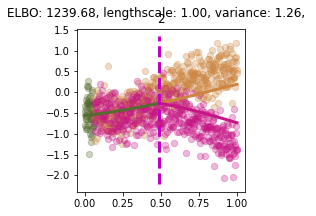

Slicing for gene 3
Uninformative until idx: 800


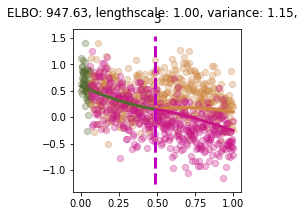

Slicing for gene 4
Uninformative until idx: 800


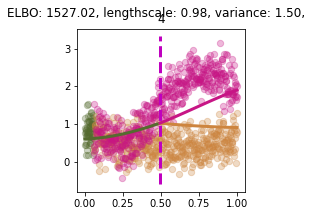

Slicing for gene 5
Uninformative until idx: 800


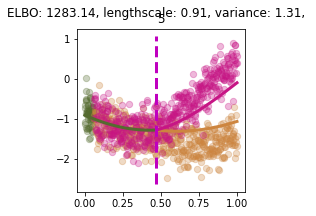

Slicing for gene 6
Uninformative until idx: 800


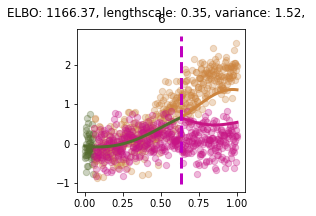

Slicing for gene 7
Uninformative until idx: 800


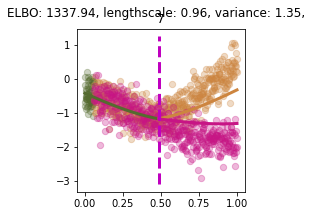

Slicing for gene 8
Uninformative until idx: 800


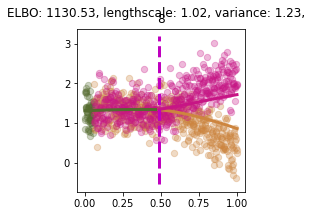

Slicing for gene 9
Uninformative until idx: 800


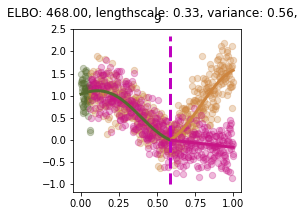

Slicing for gene 10
Uninformative until idx: 800


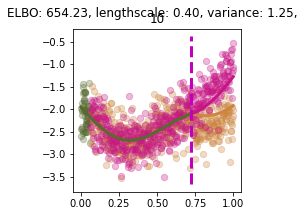

Slicing for gene 11
Uninformative until idx: 800


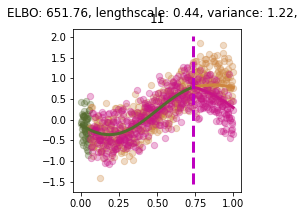

Slicing for gene 12
Uninformative until idx: 800


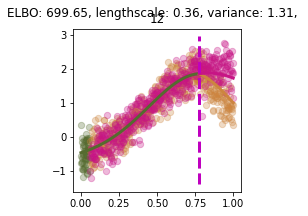

Slicing for gene 13
Uninformative until idx: 800


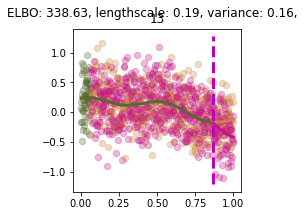

Slicing for gene 14
Uninformative until idx: 800


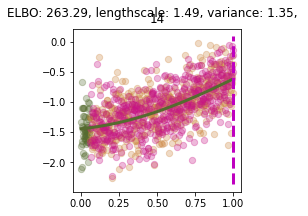

Slicing for gene 15
Uninformative until idx: 800


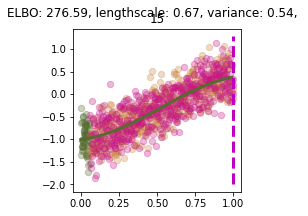

BGPs trained in 388.7 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 17 genes
Uninformative until idx: 800
MMBGP trained in 829.9 seconds


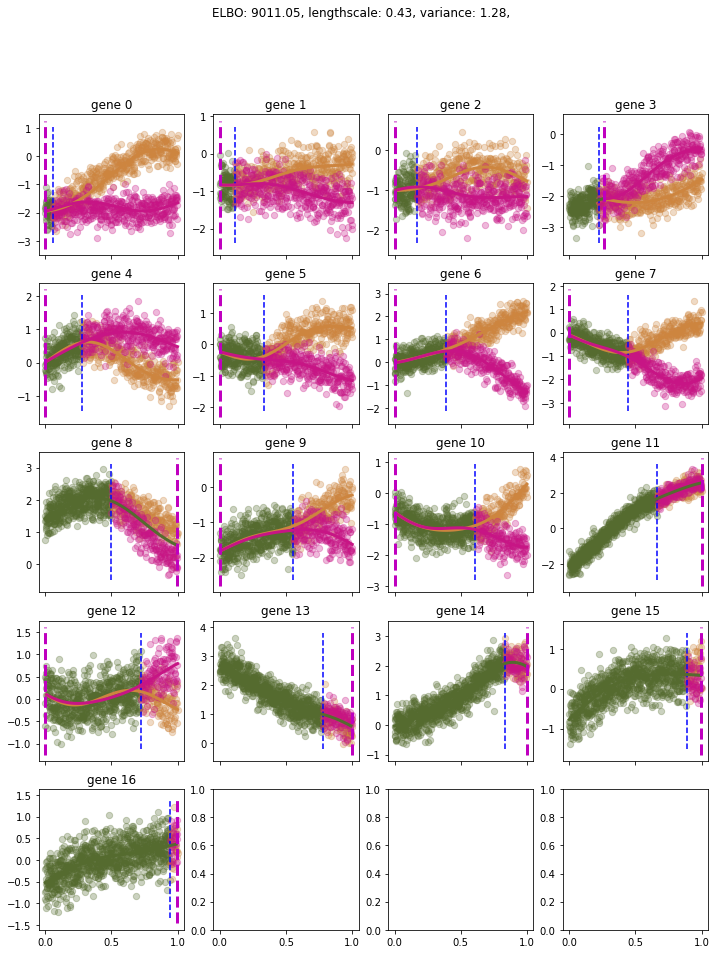

Slicing for gene 0
Uninformative until idx: 800


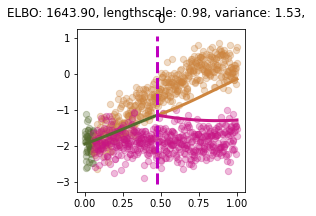

Slicing for gene 1
Uninformative until idx: 800


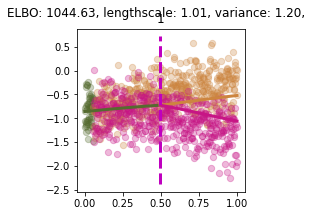

Slicing for gene 2
Uninformative until idx: 800


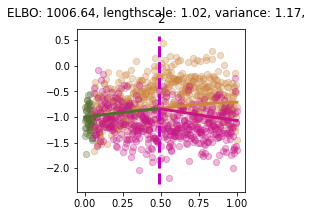

Slicing for gene 3
Uninformative until idx: 800


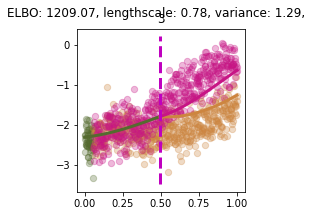

Slicing for gene 4
Uninformative until idx: 800


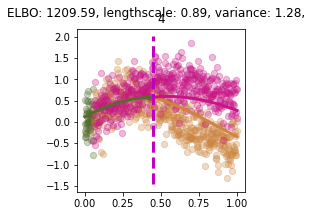

Slicing for gene 5
Uninformative until idx: 800


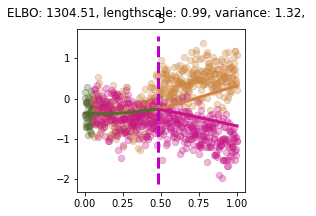

Slicing for gene 6
Uninformative until idx: 800


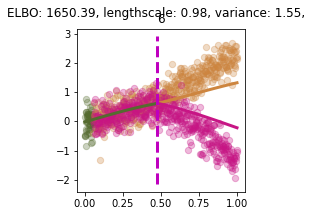

Slicing for gene 7
Uninformative until idx: 800


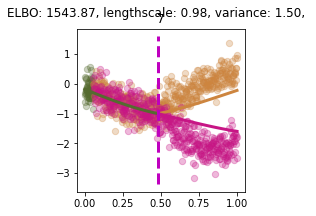

Slicing for gene 8
Uninformative until idx: 800


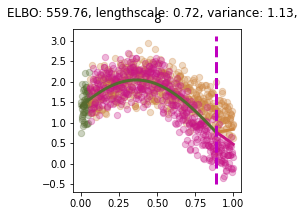

Slicing for gene 9
Uninformative until idx: 800


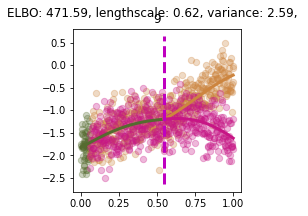

Slicing for gene 10
Uninformative until idx: 800


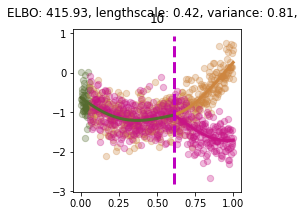

Slicing for gene 11
Uninformative until idx: 800


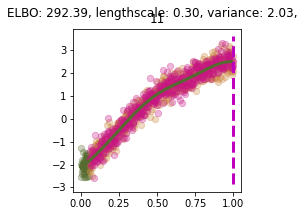

Slicing for gene 12
Uninformative until idx: 800


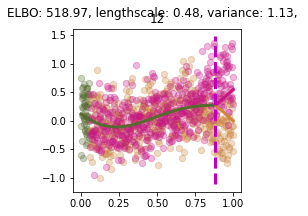

Slicing for gene 13
Uninformative until idx: 800


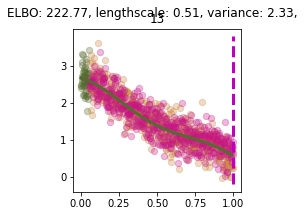

Slicing for gene 14
Uninformative until idx: 800


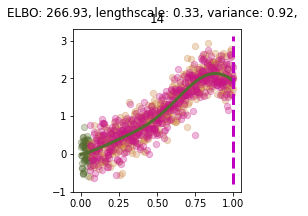

Slicing for gene 15
Uninformative until idx: 800


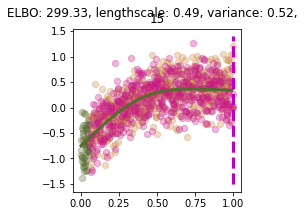

Slicing for gene 16
Uninformative until idx: 800


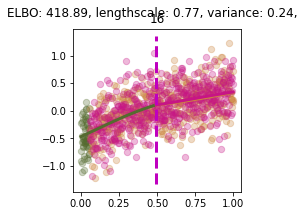

BGPs trained in 447.9 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 18 genes
Uninformative until idx: 800
MMBGP trained in 776.2 seconds


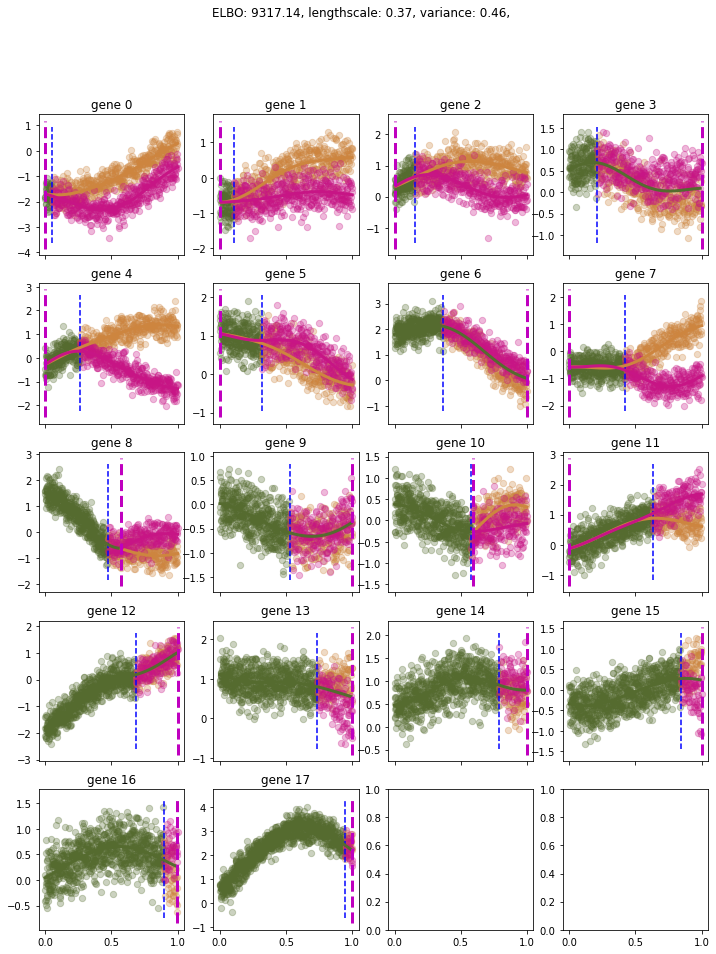

Slicing for gene 0
Uninformative until idx: 800


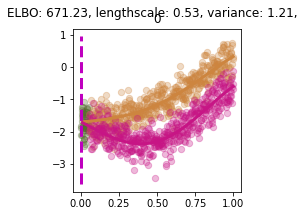

Slicing for gene 1
Uninformative until idx: 800


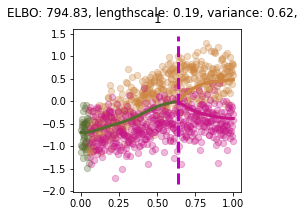

Slicing for gene 2
Uninformative until idx: 800


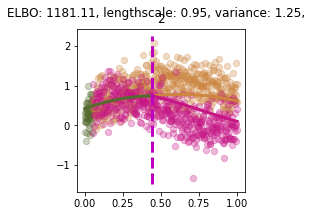

Slicing for gene 3
Uninformative until idx: 800


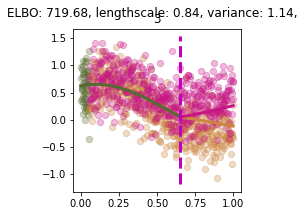

Slicing for gene 4
Uninformative until idx: 800


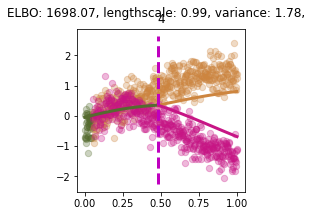

Slicing for gene 5
Uninformative until idx: 800


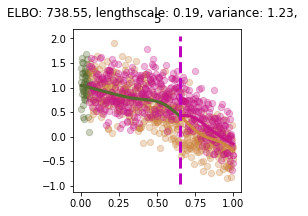

Slicing for gene 6
Uninformative until idx: 800


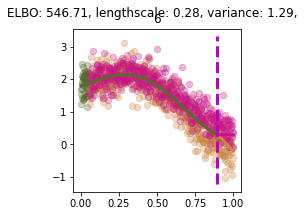

Slicing for gene 7
Uninformative until idx: 800


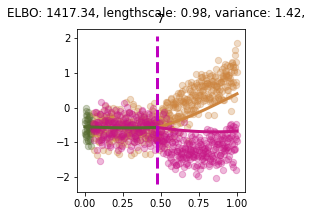

Slicing for gene 8
Uninformative until idx: 800


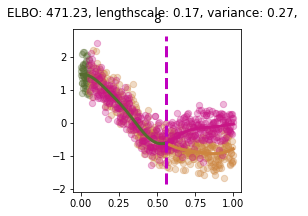

Slicing for gene 9
Uninformative until idx: 800


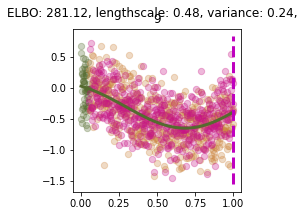

Slicing for gene 10
Uninformative until idx: 800


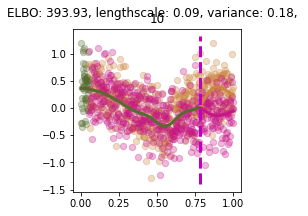

Slicing for gene 11
Uninformative until idx: 800


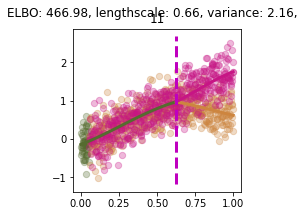

Slicing for gene 12
Uninformative until idx: 800


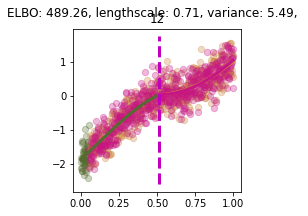

Slicing for gene 13
Uninformative until idx: 800


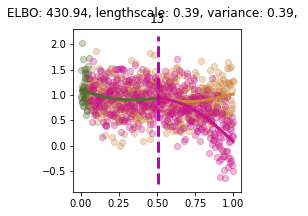

Slicing for gene 14
Uninformative until idx: 800


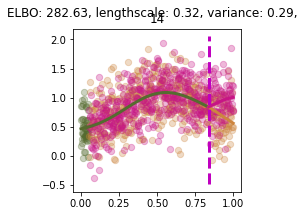

Slicing for gene 15
Uninformative until idx: 800


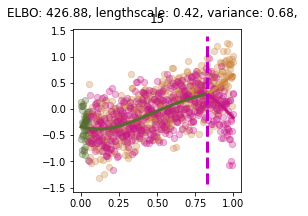

Slicing for gene 16
Uninformative until idx: 800


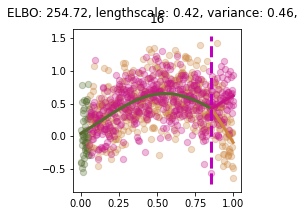

Slicing for gene 17
Uninformative until idx: 800


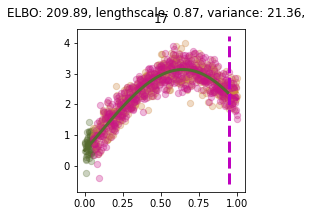

BGPs trained in 866.1 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 19 genes
Uninformative until idx: 800
MMBGP trained in 574.7 seconds


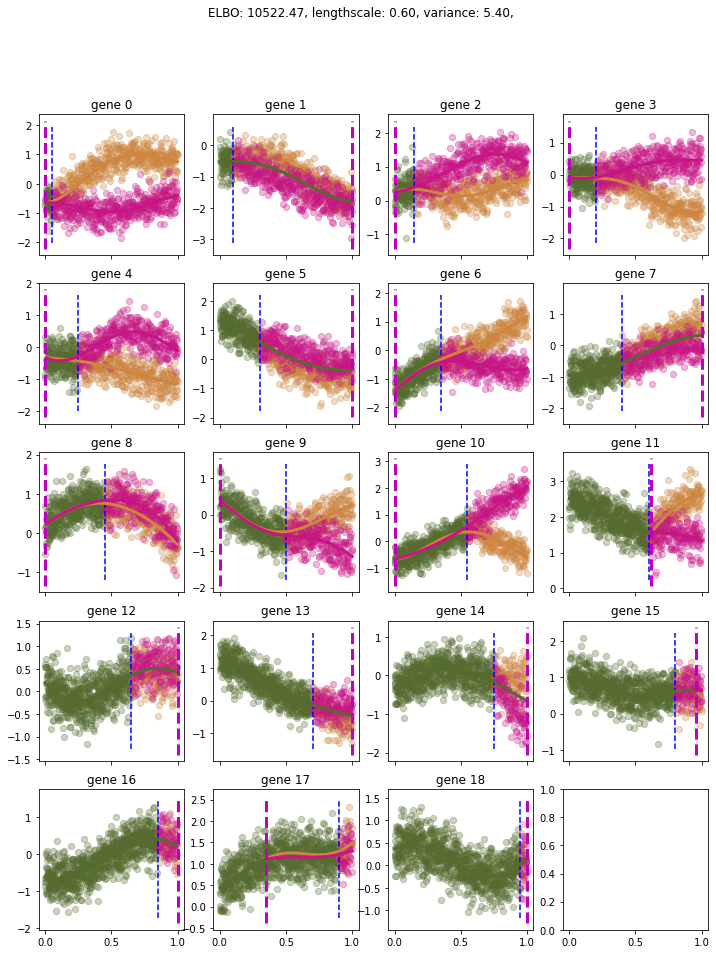

Slicing for gene 0
Uninformative until idx: 800


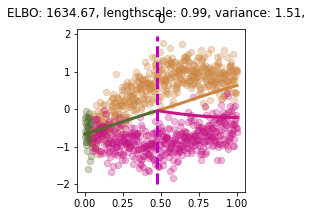

Slicing for gene 1
Uninformative until idx: 800


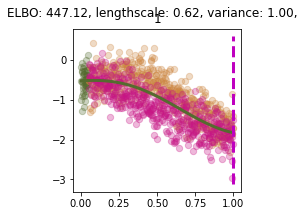

Slicing for gene 2
Uninformative until idx: 800


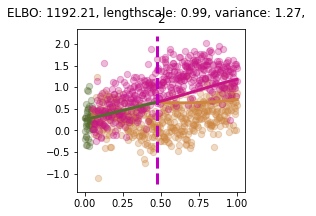

Slicing for gene 3
Uninformative until idx: 800


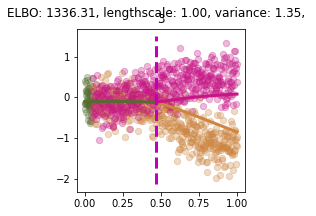

Slicing for gene 4
Uninformative until idx: 800


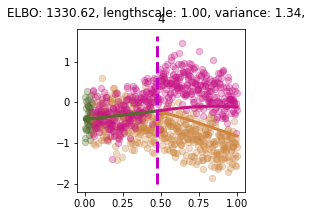

Slicing for gene 5
Uninformative until idx: 800


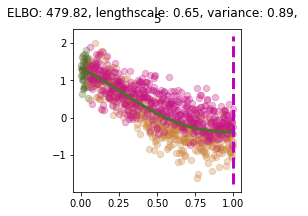

Slicing for gene 6
Uninformative until idx: 800


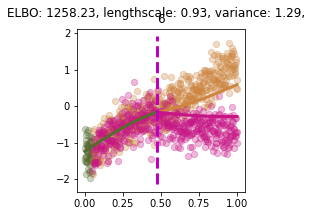

Slicing for gene 7
Uninformative until idx: 800


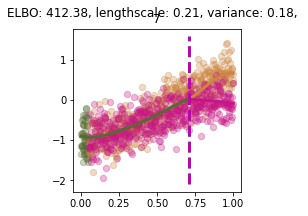

Slicing for gene 8
Uninformative until idx: 800


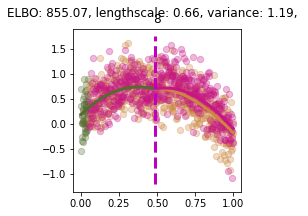

Slicing for gene 9
Uninformative until idx: 800


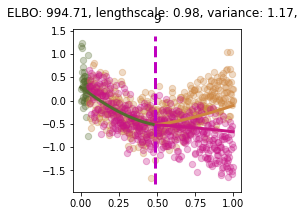

Slicing for gene 10
Uninformative until idx: 800


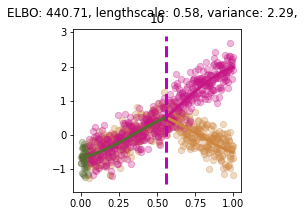

Slicing for gene 11
Uninformative until idx: 800


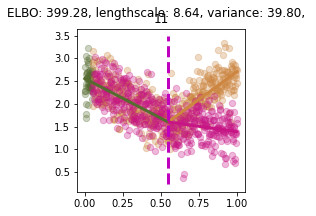

Slicing for gene 12
Uninformative until idx: 800


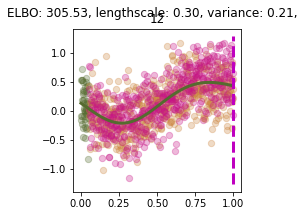

Slicing for gene 13
Uninformative until idx: 800


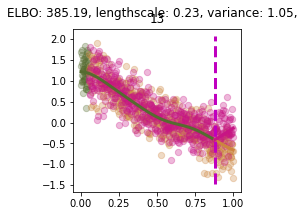

Slicing for gene 14
Uninformative until idx: 800


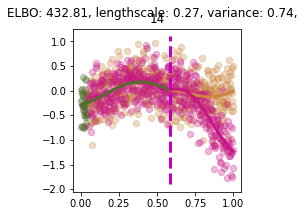

Slicing for gene 15
Uninformative until idx: 800


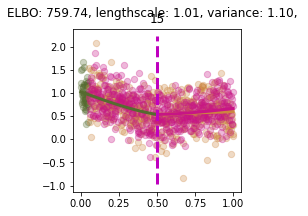

Slicing for gene 16
Uninformative until idx: 800


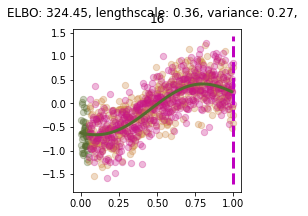

Slicing for gene 17
Uninformative until idx: 800


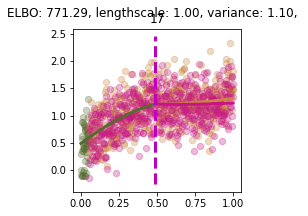

Slicing for gene 18
Uninformative until idx: 800


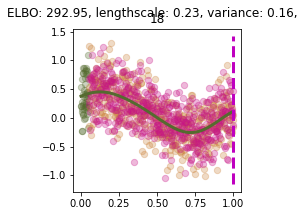

BGPs trained in 497.1 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 20 genes
Uninformative until idx: 800
MMBGP trained in 355.3 seconds


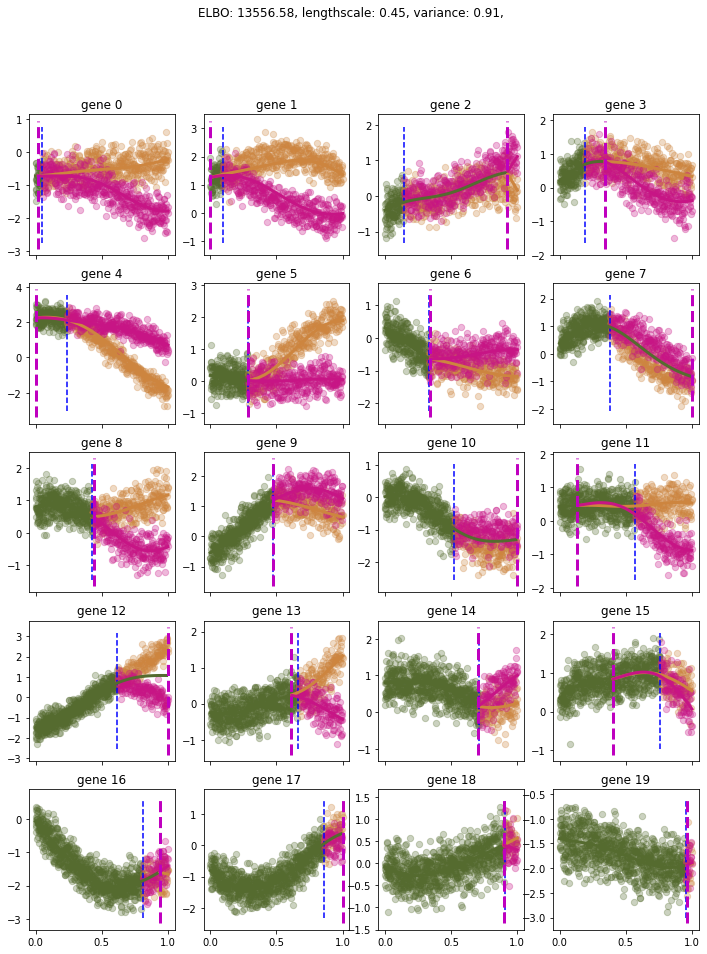

Slicing for gene 0
Uninformative until idx: 800


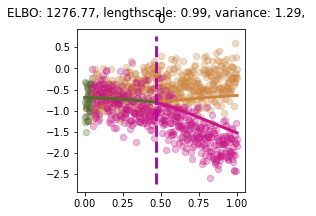

Slicing for gene 1
Uninformative until idx: 800


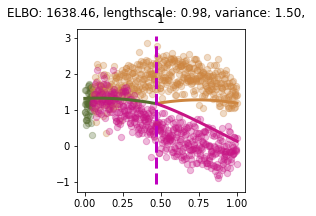

Slicing for gene 2
Uninformative until idx: 800


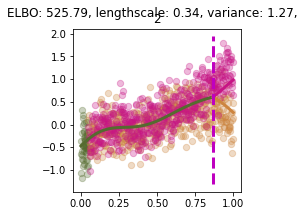

Slicing for gene 3
Uninformative until idx: 800


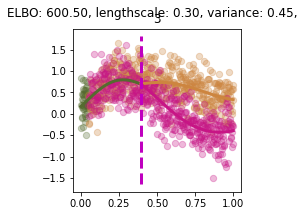

Slicing for gene 4
Uninformative until idx: 800


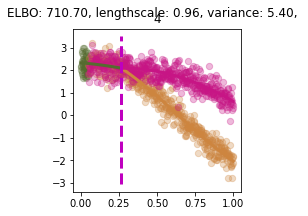

Slicing for gene 5
Uninformative until idx: 800


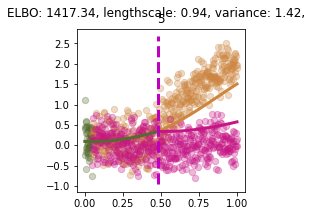

Slicing for gene 6
Uninformative until idx: 800


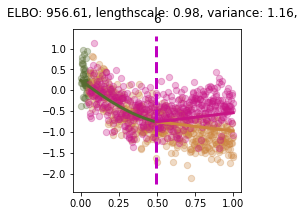

Slicing for gene 7
Uninformative until idx: 800


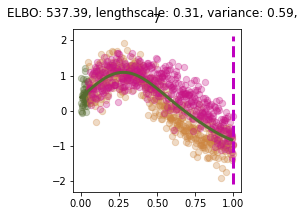

Slicing for gene 8
Uninformative until idx: 800


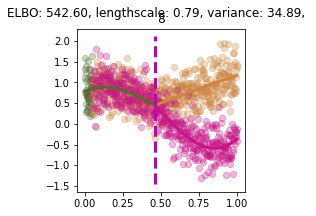

Slicing for gene 9
Uninformative until idx: 800


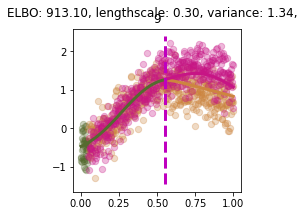

Slicing for gene 10
Uninformative until idx: 800


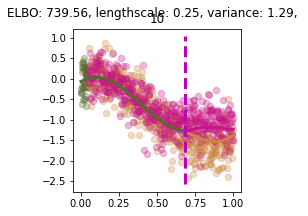

Slicing for gene 11
Uninformative until idx: 800


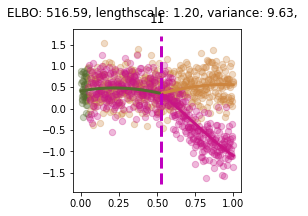

Slicing for gene 12
Uninformative until idx: 800


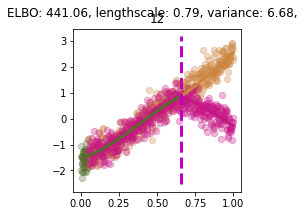

Slicing for gene 13
Uninformative until idx: 800


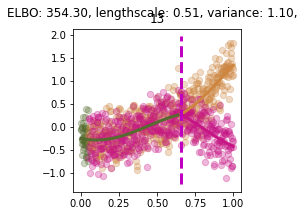

Slicing for gene 14
Uninformative until idx: 800


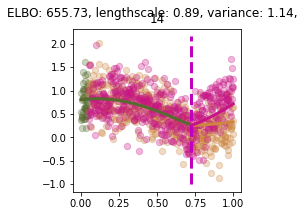

Slicing for gene 15
Uninformative until idx: 800


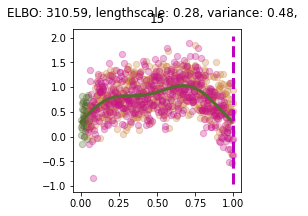

Slicing for gene 16
Uninformative until idx: 800


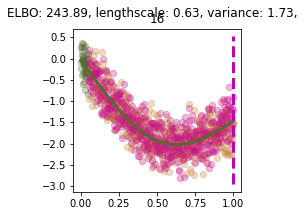

Slicing for gene 17
Uninformative until idx: 800


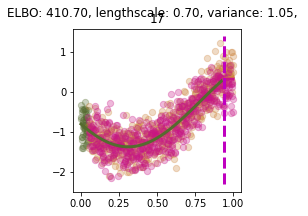

Slicing for gene 18
Uninformative until idx: 800


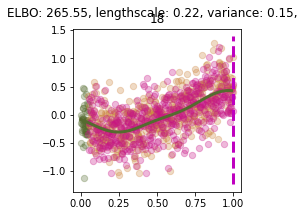

Slicing for gene 19
Uninformative until idx: 800


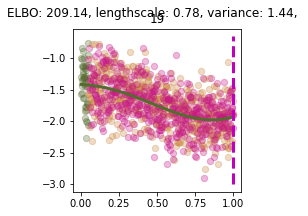

BGPs trained in 579.1 seconds


In [7]:
from MMBGP.training_helpers import fixed_bps
import time


NOISE = 0.1
LENGTHSCALE = 0.5
NUM_SAMPLES = 1
NUM_CELLS = 1_000
HIGH_PRIOR_CONFIDENCE = 0.8
LOW_PRIOR_CONFIDENCE = 0.8
UNINFORMATIVE_UNTIL = 0.8
MAX_NUM_GENES = 20
MAX_ITER = 1_000

def get_optimiser() -> AssignGPOptimiser:
    # return ElvijsAmazingOptimiser(base_optimiser=ScipyOptimiser(maxiter=MAX_ITER))
    return ScipyOptimiser(maxiter=MAX_ITER)


results: List[Result] = []
for num_genes in range(1, MAX_NUM_GENES + 1, 1):    
    true_bps = [i/(num_genes + 1) for i in range(1, num_genes + 1, 1)]

    # Generate data
    dummy_model = get_assigngp_with_target_bps(
        true_bps, 
        lengthscale=LENGTHSCALE, 
        noise_variance=NOISE,
    )
    synthetic_noisy_data = get_synthetic_noisy_branched_data(
        dummy_model, 
        num_samples=NUM_SAMPLES, 
        x_pts=NUM_CELLS,
    )

    print(f"Processing synthetic data for {num_genes} genes")
    for i, data in enumerate(synthetic_noisy_data):
        #
        # MMBGP
        #
        st_mmbgp = time.time()
        mmbgp = construct_assigngp_model(
            gene_expression=data,
            phi_constructor=FunkyPrior(
                data,
                informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
                uninformative_until=UNINFORMATIVE_UNTIL,
            ),
            initial_branching_points=[0.5]*data.num_genes,  # Don't start at the true locations
        )
    
        optimiser = get_optimiser()
    
        try:
            trained_mmbgp = optimiser.train(mmbgp)
            et_mmbgp = time.time()
            print(f"MMBGP trained in {et_mmbgp - st_mmbgp:.1f} seconds")
        except Exception as ex:
            print(f"Error in training: {ex}")
            trained_mmbgp = mmbgp
    
        plot_model_snapshot(trained_mmbgp, genes=data, alpha=0.3)
        plt.show()
    
        #
        # BGPs
        #
        bgps = []
        st_bgps = time.time()

        for i in range(data.num_genes):
            print(f"Slicing for gene {i}")
    
            sliced_data = GeneExpressionData(
                t=data.t,
                Y=data.Y[:, i].reshape(-1, 1),
                state=data.state,
                gene_labels=[f"{i}"]
            )
   
            bgp = construct_assigngp_model(
                gene_expression=sliced_data,
                phi_constructor=FunkyPrior(
                    sliced_data,
                    informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
                    uninformative_until=UNINFORMATIVE_UNTIL,
                ),
                initial_branching_points=[0.5],  # Do not initialise to true locations
            )
    
            optimiser = get_optimiser()
        
            try:
                trained_bgp = optimiser.train(bgp)
            except Exception as ex:
                print(f"Error in training: {ex}")
                trained_bgp = bgp
            
            plot_model_snapshot(trained_bgp, genes=sliced_data, alpha=0.3)
            plt.show()
    
            bgps.append(trained_bgp)
            et_bgps = time.time()
        print(f"BGPs trained in {et_bgps - st_bgps:.1f} seconds")
    
        result = Result(
            data=data,
            true_bps=np.array(true_bps),
            mmbgp=trained_mmbgp,
            bgps=bgps,
            time_mmbgp_s=et_mmbgp - st_mmbgp,
            time_bgps_s=et_bgps - st_bgps, 
        )
        results.append(result)

In [8]:
df = convert_results_to_df(results)
df.head(30)

,sample_id,time_mmbgp_s,mmbgp_bp_rmse,time_bgps_s,bgp_bp_rmse
0,0,22.028126,0.070571,25.134640,0.065566
1,1,20.348139,0.103850,46.339488,0.259096
2,2,595.266888,0.353553,62.882311,0.137498
3,3,62.060511,0.177995,106.469735,0.143418
4,4,827.481226,0.414996,96.391742,0.366608
5,5,117.091404,0.410471,160.375571,0.305743
6,6,409.024985,0.389350,173.650489,0.329449
7,7,269.414332,0.376865,211.798379,0.259717
8,8,165.825522,0.487997,231.132214,0.351886
9,9,277.126043,0.267462,566.189325,0.250794


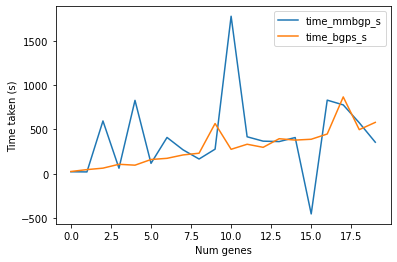

In [9]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()

for col in ['time_mmbgp_s', 'time_bgps_s']:
    ax.plot(df["sample_id"], df[col], label=col)

ax.set_ylabel("Time taken (s)")
ax.set_xlabel("Num genes")

ax.legend(loc="best")
    
plt.show()

In [11]:
res = results[0]
res.mmbgp

name,class,transform,prior,trainable,shape,dtype,value
AssignGP.ZExpanded,Parameter,Identity,,False,"(180, 2)",float64,"[[0., 1...."
AssignGP.kernel.kern.variance,Parameter,Softplus,,True,(),float64,8.060659595644399
AssignGP.kernel.kern.lengthscales,Parameter,Softplus,,True,(),float64,0.9119643774056834
AssignGP.kernel.Bv,Parameter,Sigmoid,,True,"(1,)",float64,[0.57057059]
AssignGP.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.10001849263141979
AssignGP.logPhi,Parameter,Identity,,True,"(1000, 3000)",float64,"[[-20.72326584, -0.69314718, -0.69314718..."


# Try with the other optimiser 

10 samples drawn, 0 valid samples constructed
Processing synthetic data for 1 genes
Uninformative until idx: 80
MMBGP trained in 21.7 seconds


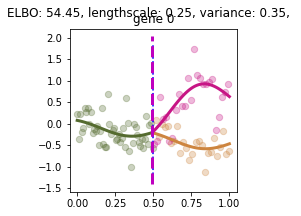

Slicing for gene 0
Uninformative until idx: 80


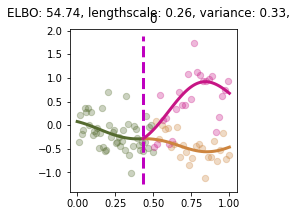

BGPs trained in 17.9 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 2 genes
Uninformative until idx: 80
MMBGP trained in 36.7 seconds


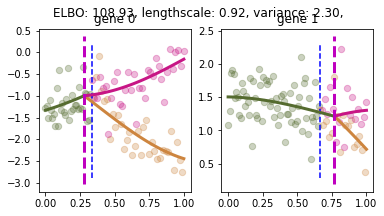

Slicing for gene 0
Uninformative until idx: 80


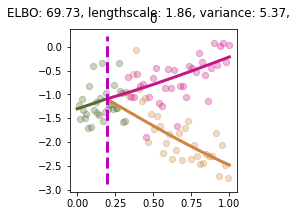

Slicing for gene 1
Uninformative until idx: 80


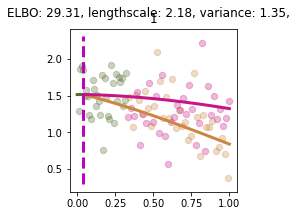

BGPs trained in 43.6 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 3 genes
Uninformative until idx: 80
MMBGP trained in 50.7 seconds


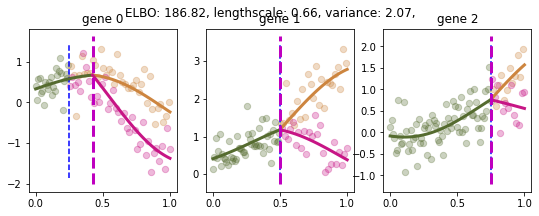

Slicing for gene 0
Uninformative until idx: 80


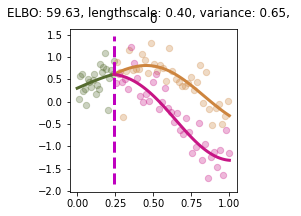

Slicing for gene 1
Uninformative until idx: 80


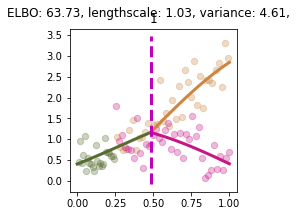

Slicing for gene 2
Uninformative until idx: 80


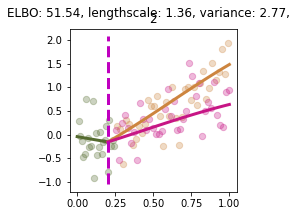

BGPs trained in 60.5 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 4 genes
Uninformative until idx: 80
MMBGP trained in 66.8 seconds


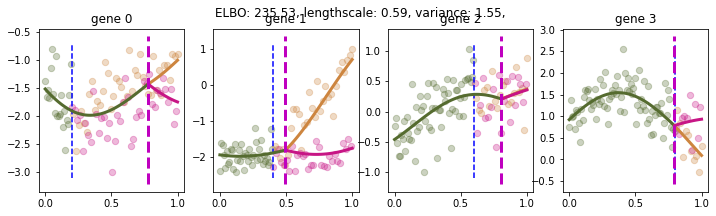

Slicing for gene 0
Uninformative until idx: 80


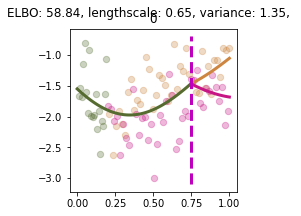

Slicing for gene 1
Uninformative until idx: 80


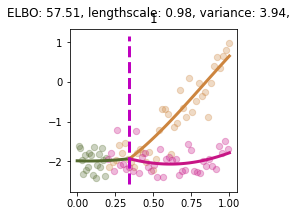

Slicing for gene 2
Uninformative until idx: 80


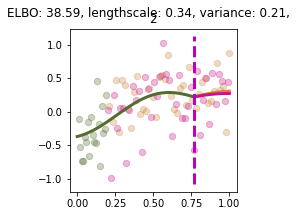

Slicing for gene 3
Uninformative until idx: 80


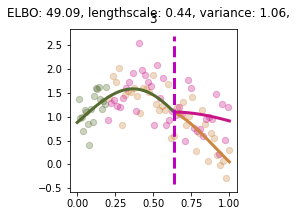

BGPs trained in 90.6 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 5 genes
Uninformative until idx: 80
MMBGP trained in 99.5 seconds


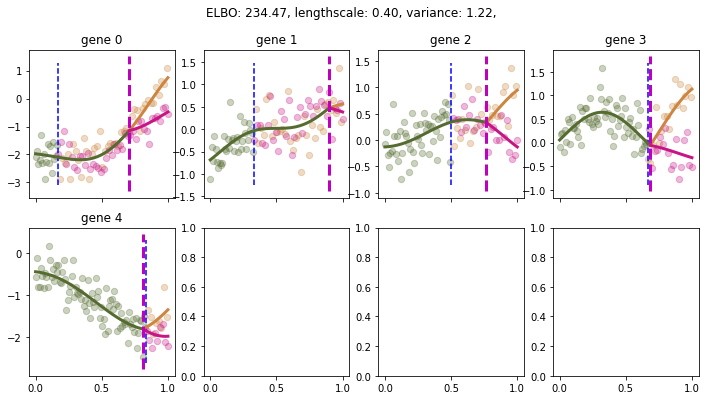

Slicing for gene 0
Uninformative until idx: 80


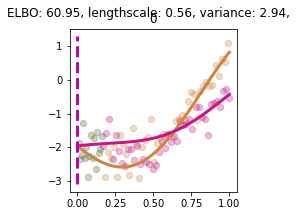

Slicing for gene 1
Uninformative until idx: 80


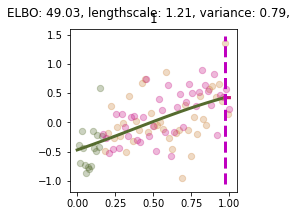

Slicing for gene 2
Uninformative until idx: 80


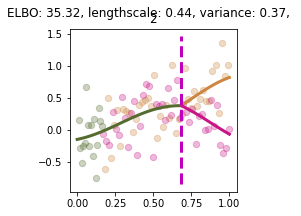

Slicing for gene 3
Uninformative until idx: 80


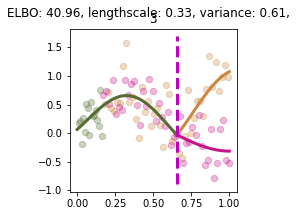

Slicing for gene 4
Uninformative until idx: 80


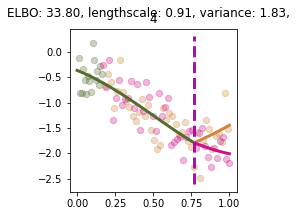

BGPs trained in 110.2 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 6 genes
Uninformative until idx: 80
Error in training:  Input is not invertible.
	 [[node f0f2_1/invKbb (defined at /Users/elvijssarkans/dev/MMBGP/MMBGP/assigngp.py:154) ]] [Op:__inference__tf_eval_15482960]

Errors may have originated from an input operation.
Input Source operations connected to node f0f2_1/invKbb:
 f0f2_1/add_2 (defined at /Users/elvijssarkans/dev/MMBGP/MMBGP/assigngp.py:153)

Function call stack:
_tf_eval



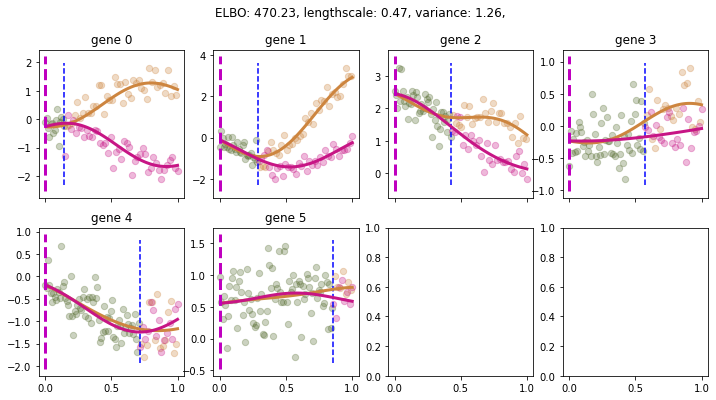

Slicing for gene 0
Uninformative until idx: 80


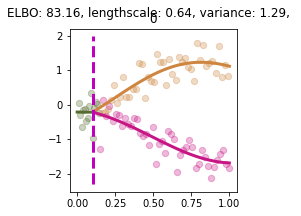

Slicing for gene 1
Uninformative until idx: 80


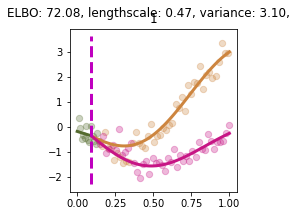

Slicing for gene 2
Uninformative until idx: 80


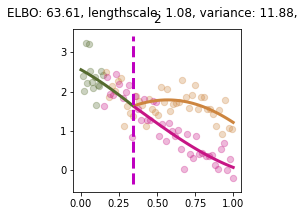

Slicing for gene 3
Uninformative until idx: 80


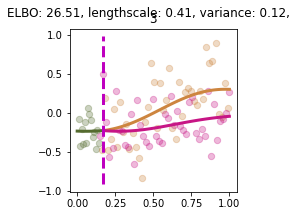

Slicing for gene 4
Uninformative until idx: 80


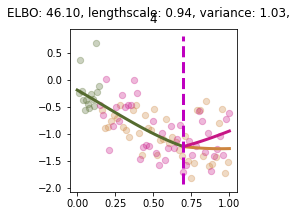

Slicing for gene 5
Uninformative until idx: 80


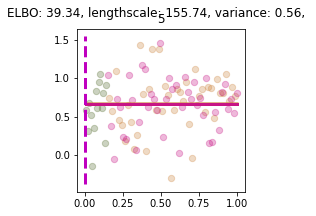

BGPs trained in 119.4 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 7 genes
Uninformative until idx: 80
MMBGP trained in 127.1 seconds


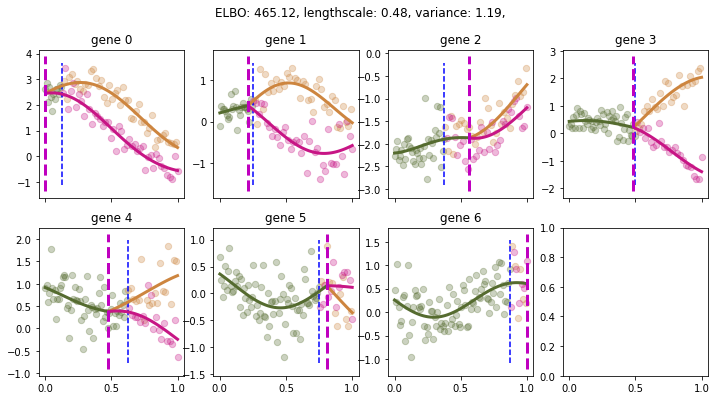

Slicing for gene 0
Uninformative until idx: 80


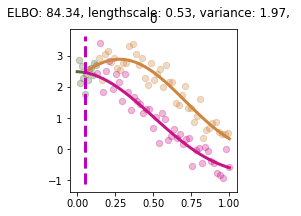

Slicing for gene 1
Uninformative until idx: 80


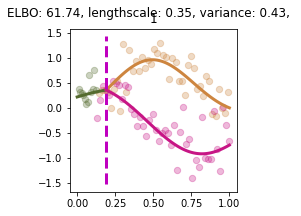

Slicing for gene 2
Uninformative until idx: 80


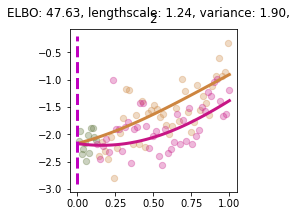

Slicing for gene 3
Uninformative until idx: 80


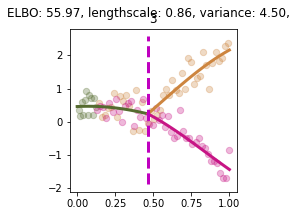

Slicing for gene 4
Uninformative until idx: 80


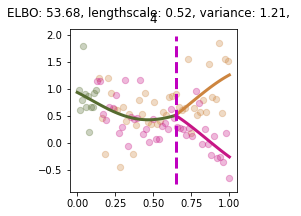

Slicing for gene 5
Uninformative until idx: 80


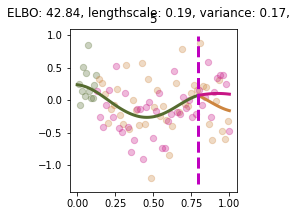

Slicing for gene 6
Uninformative until idx: 80


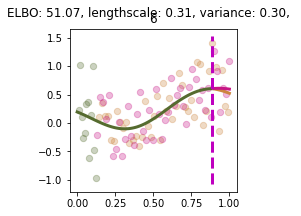

BGPs trained in 150.0 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 8 genes
Uninformative until idx: 80
MMBGP trained in 157.0 seconds


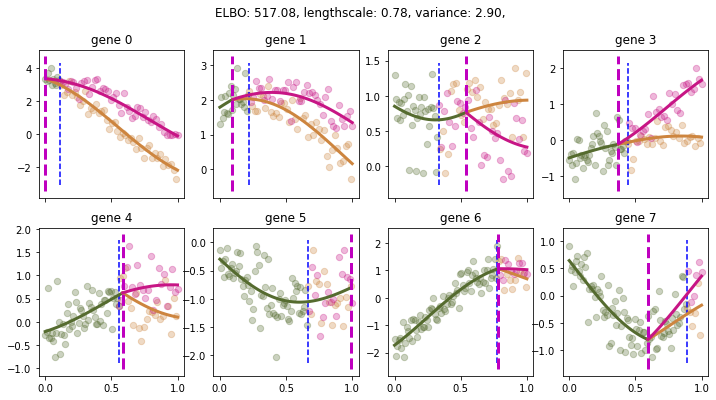

Slicing for gene 0
Uninformative until idx: 80


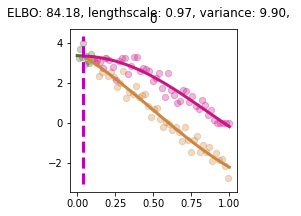

Slicing for gene 1
Uninformative until idx: 80


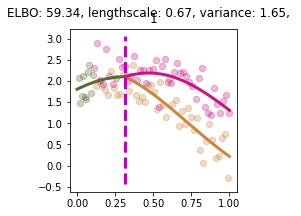

Slicing for gene 2
Uninformative until idx: 80


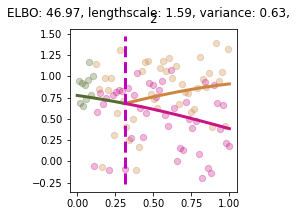

Slicing for gene 3
Uninformative until idx: 80


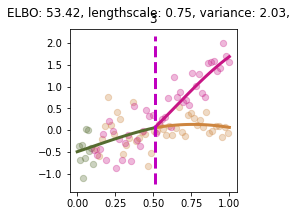

Slicing for gene 4
Uninformative until idx: 80


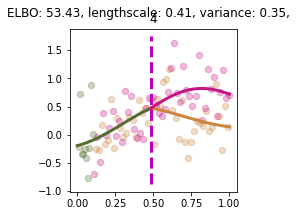

Slicing for gene 5
Uninformative until idx: 80


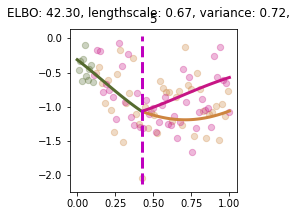

Slicing for gene 6
Uninformative until idx: 80


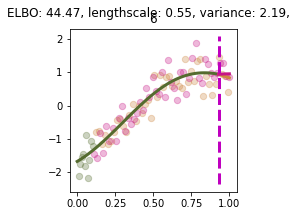

Slicing for gene 7
Uninformative until idx: 80


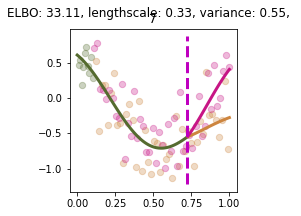

BGPs trained in 197.9 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 9 genes
Uninformative until idx: 80
MMBGP trained in 188.4 seconds


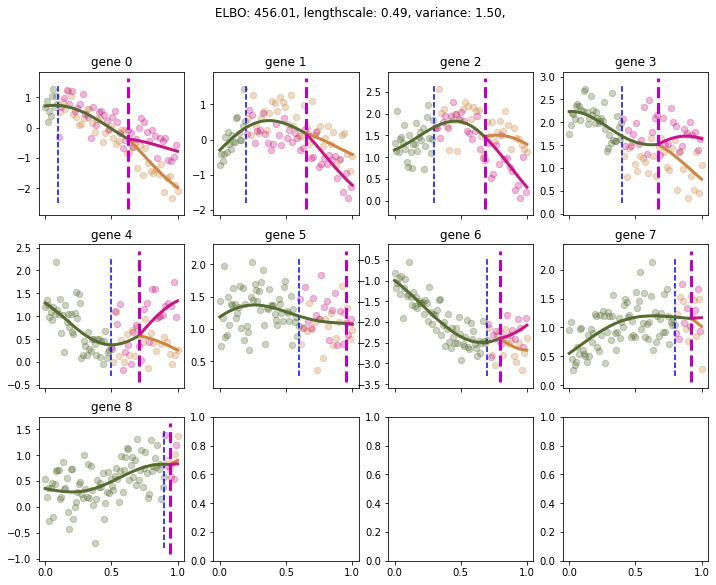

Slicing for gene 0
Uninformative until idx: 80


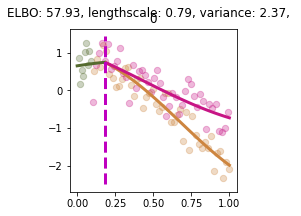

Slicing for gene 1
Uninformative until idx: 80


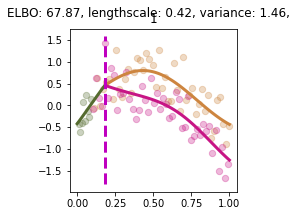

Slicing for gene 2
Uninformative until idx: 80


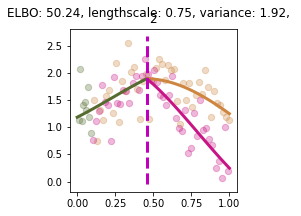

Slicing for gene 3
Uninformative until idx: 80


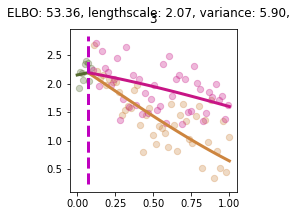

Slicing for gene 4
Uninformative until idx: 80


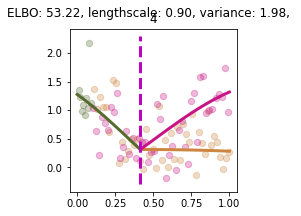

Slicing for gene 5
Uninformative until idx: 80


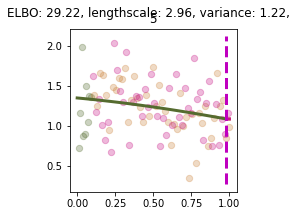

Slicing for gene 6
Uninformative until idx: 80


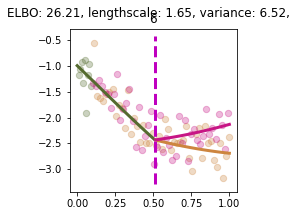

Slicing for gene 7
Uninformative until idx: 80


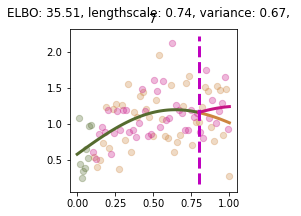

Slicing for gene 8
Uninformative until idx: 80


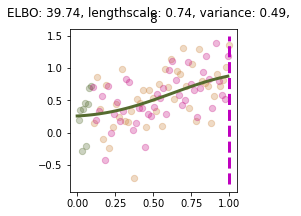

BGPs trained in 211.4 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 10 genes
Uninformative until idx: 80
MMBGP trained in 191.5 seconds


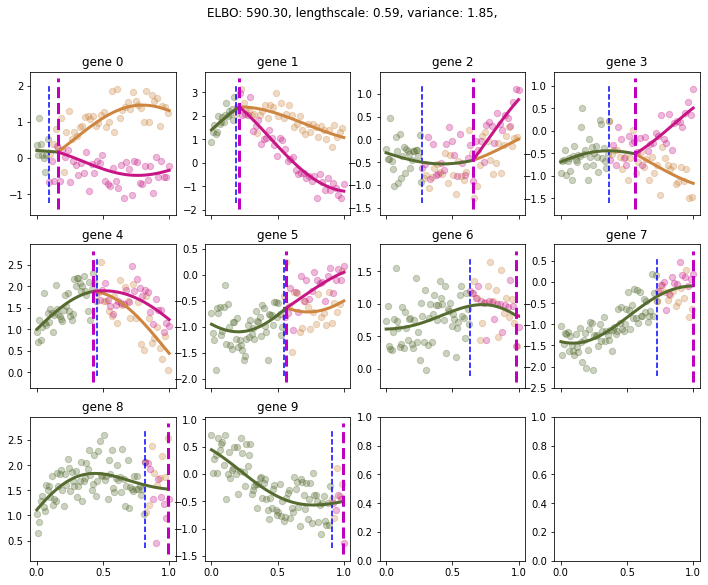

Slicing for gene 0
Uninformative until idx: 80


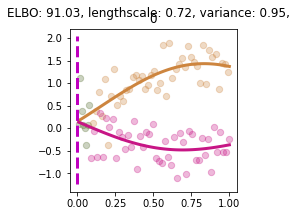

Slicing for gene 1
Uninformative until idx: 80


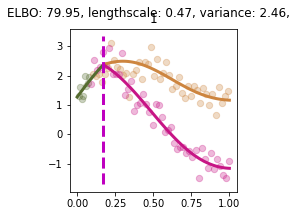

Slicing for gene 2
Uninformative until idx: 80


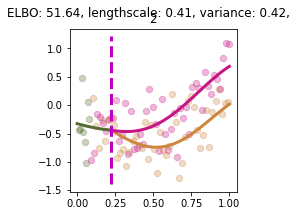

Slicing for gene 3
Uninformative until idx: 80


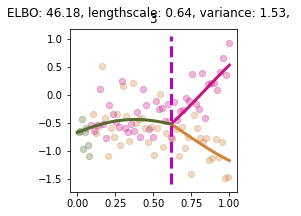

Slicing for gene 4
Uninformative until idx: 80


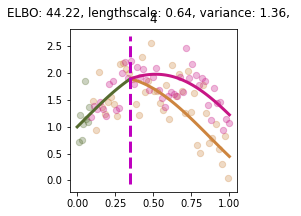

Slicing for gene 5
Uninformative until idx: 80


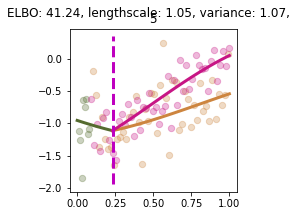

Slicing for gene 6
Uninformative until idx: 80


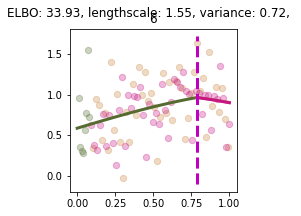

Slicing for gene 7
Uninformative until idx: 80


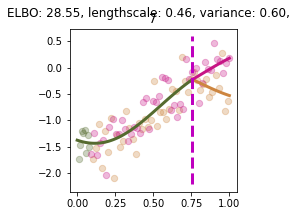

Slicing for gene 8
Uninformative until idx: 80


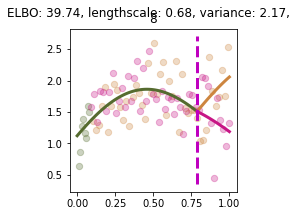

Slicing for gene 9
Uninformative until idx: 80


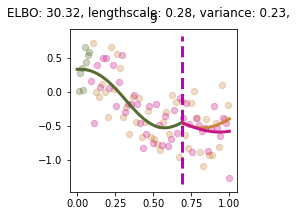

BGPs trained in 262.6 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 11 genes
Uninformative until idx: 80
MMBGP trained in 261.0 seconds


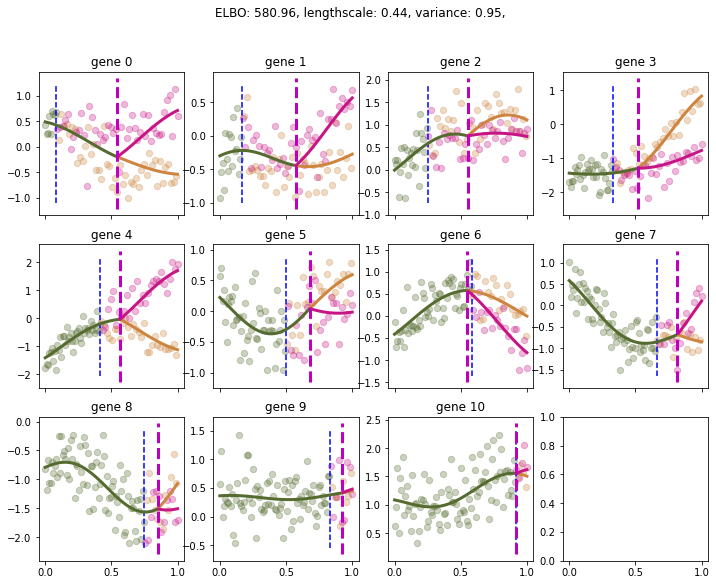

Slicing for gene 0
Uninformative until idx: 80


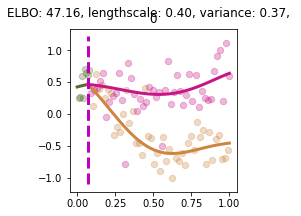

Slicing for gene 1
Uninformative until idx: 80


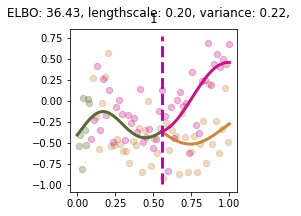

Slicing for gene 2
Uninformative until idx: 80


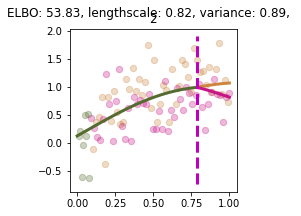

Slicing for gene 3
Uninformative until idx: 80


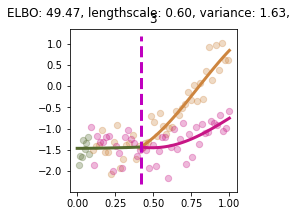

Slicing for gene 4
Uninformative until idx: 80


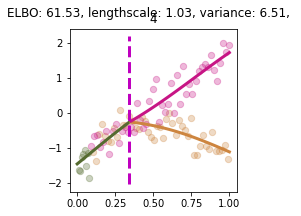

Slicing for gene 5
Uninformative until idx: 80


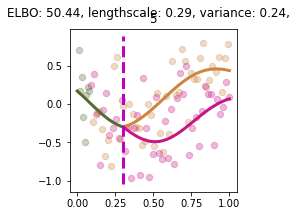

Slicing for gene 6
Uninformative until idx: 80


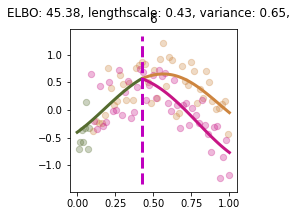

Slicing for gene 7
Uninformative until idx: 80


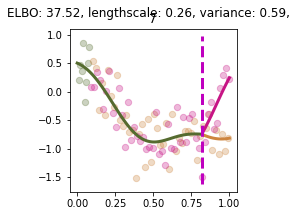

Slicing for gene 8
Uninformative until idx: 80


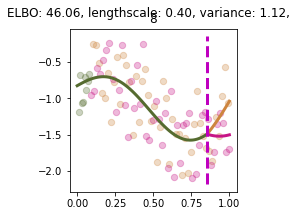

Slicing for gene 9
Uninformative until idx: 80


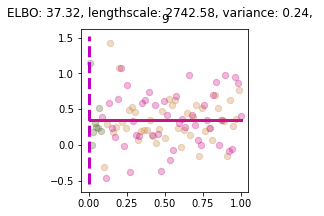

Slicing for gene 10
Uninformative until idx: 80


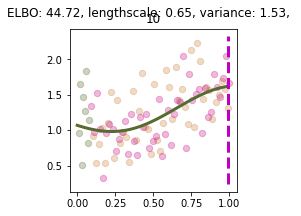

BGPs trained in 249.7 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 12 genes
Uninformative until idx: 80
MMBGP trained in 280.3 seconds


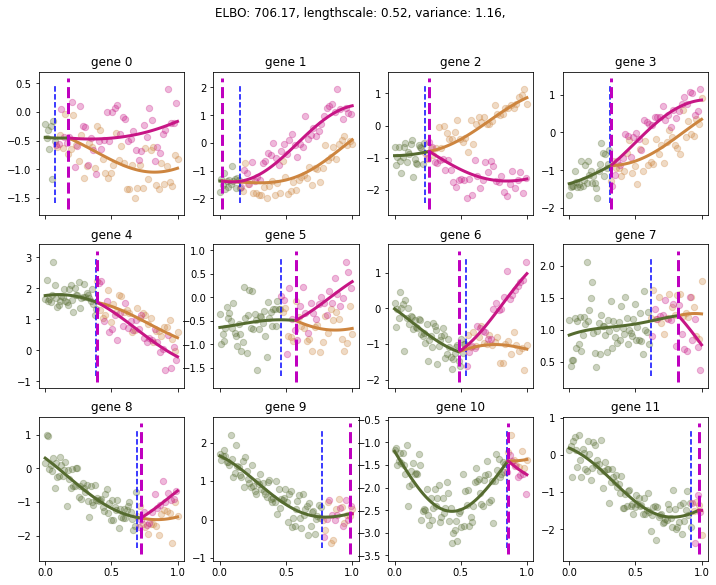

Slicing for gene 0
Uninformative until idx: 80


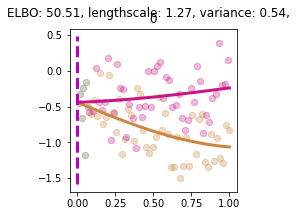

Slicing for gene 1
Uninformative until idx: 80


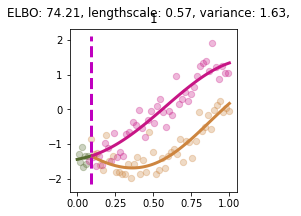

Slicing for gene 2
Uninformative until idx: 80


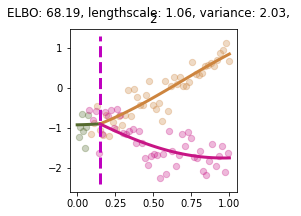

Slicing for gene 3
Uninformative until idx: 80


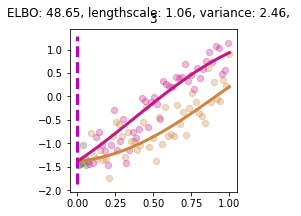

Slicing for gene 4
Uninformative until idx: 80


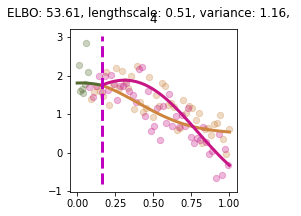

Slicing for gene 5
Uninformative until idx: 80


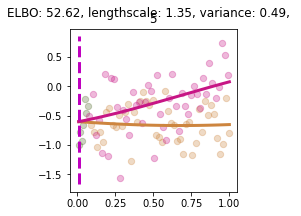

Slicing for gene 6
Uninformative until idx: 80


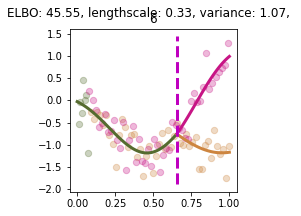

Slicing for gene 7
Uninformative until idx: 80


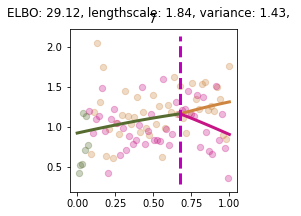

Slicing for gene 8
Uninformative until idx: 80


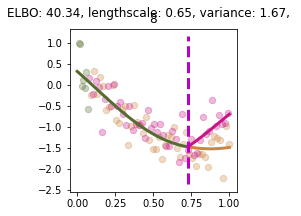

Slicing for gene 9
Uninformative until idx: 80


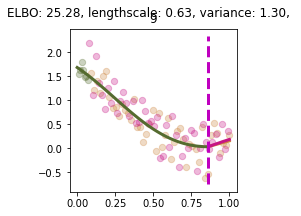

Slicing for gene 10
Uninformative until idx: 80


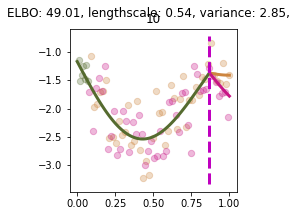

Slicing for gene 11
Uninformative until idx: 80


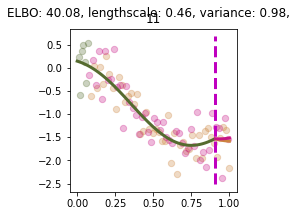

BGPs trained in 329.3 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 13 genes
Uninformative until idx: 80
MMBGP trained in 335.2 seconds


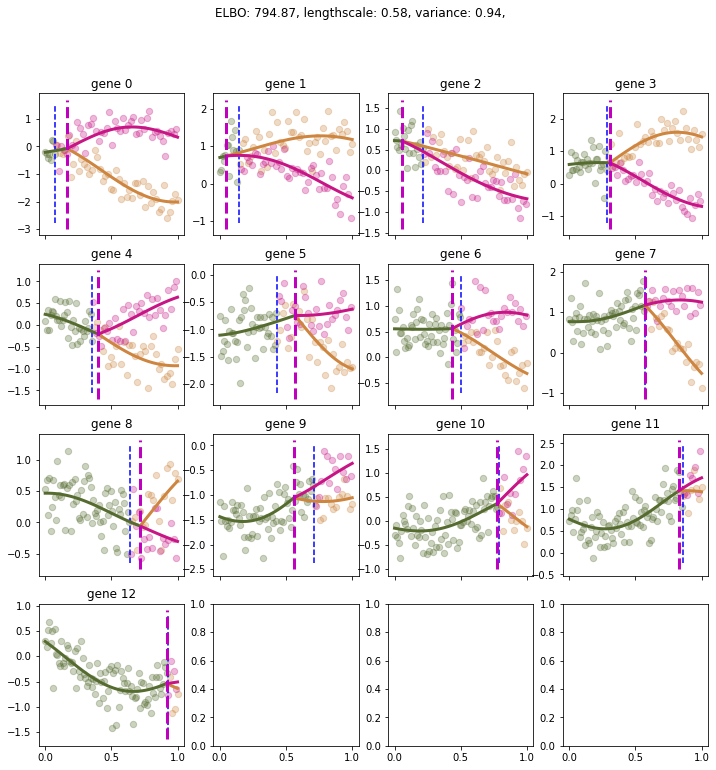

Slicing for gene 0
Uninformative until idx: 80


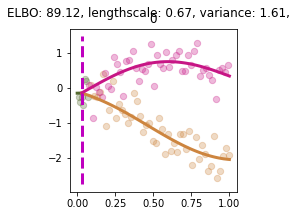

Slicing for gene 1
Uninformative until idx: 80


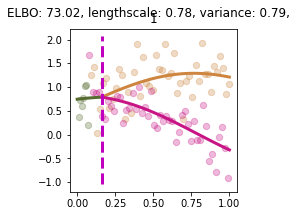

Slicing for gene 2
Uninformative until idx: 80


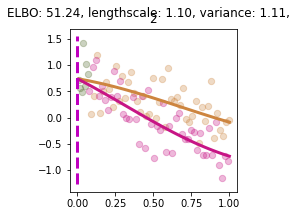

Slicing for gene 3
Uninformative until idx: 80


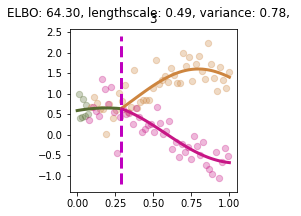

Slicing for gene 4
Uninformative until idx: 80


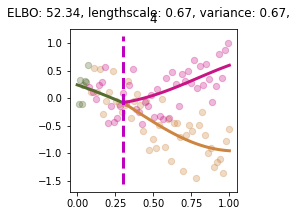

Slicing for gene 5
Uninformative until idx: 80


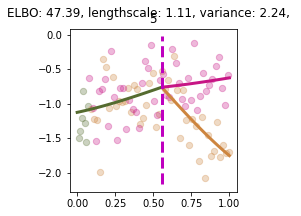

Slicing for gene 6
Uninformative until idx: 80


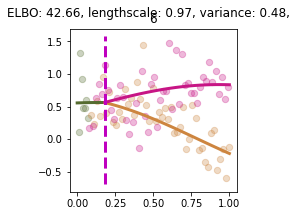

Slicing for gene 7
Uninformative until idx: 80


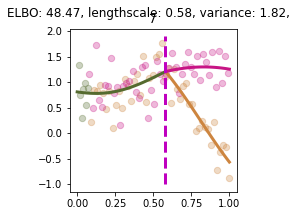

Slicing for gene 8
Uninformative until idx: 80


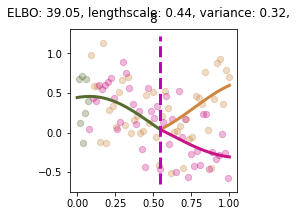

Slicing for gene 9
Uninformative until idx: 80


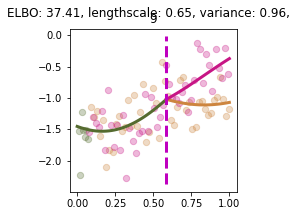

Slicing for gene 10
Uninformative until idx: 80


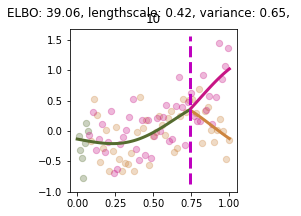

Slicing for gene 11
Uninformative until idx: 80


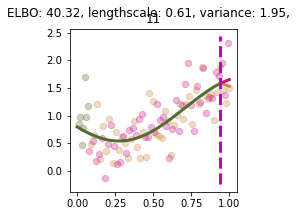

Slicing for gene 12
Uninformative until idx: 80


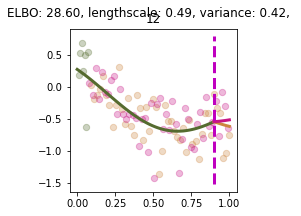

BGPs trained in 301.8 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 14 genes
Uninformative until idx: 80
MMBGP trained in 322.7 seconds


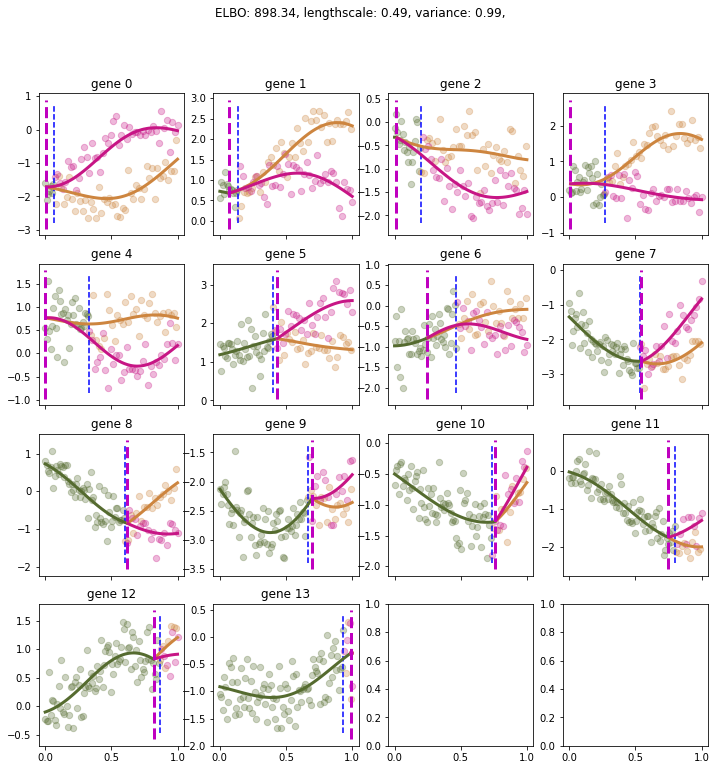

Slicing for gene 0
Uninformative until idx: 80


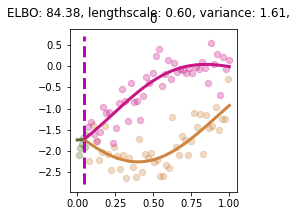

Slicing for gene 1
Uninformative until idx: 80


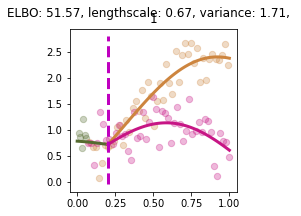

Slicing for gene 2
Uninformative until idx: 80


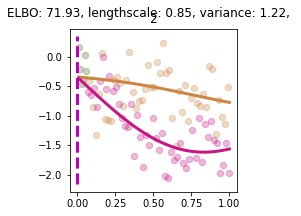

Slicing for gene 3
Uninformative until idx: 80


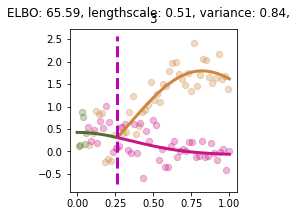

Slicing for gene 4
Uninformative until idx: 80


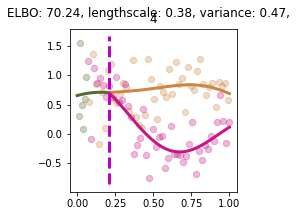

Slicing for gene 5
Uninformative until idx: 80


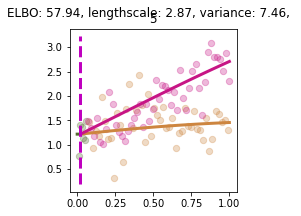

Slicing for gene 6
Uninformative until idx: 80


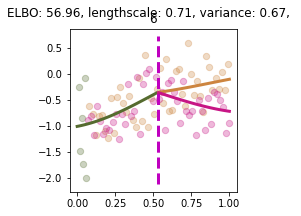

Slicing for gene 7
Uninformative until idx: 80


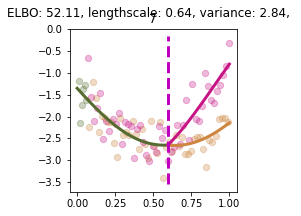

Slicing for gene 8
Uninformative until idx: 80


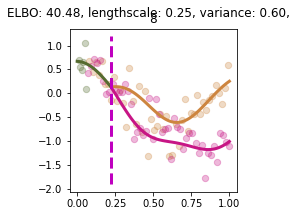

Slicing for gene 9
Uninformative until idx: 80


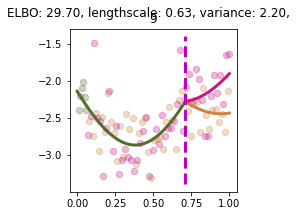

Slicing for gene 10
Uninformative until idx: 80


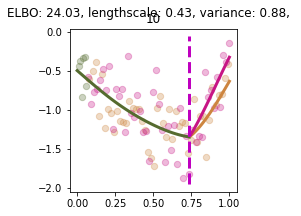

Slicing for gene 11
Uninformative until idx: 80


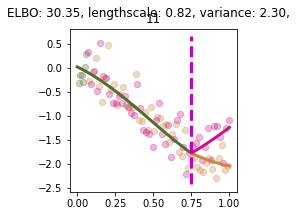

Slicing for gene 12
Uninformative until idx: 80


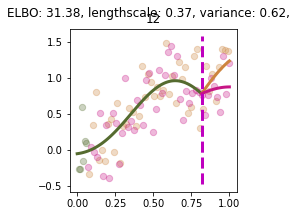

Slicing for gene 13
Uninformative until idx: 80


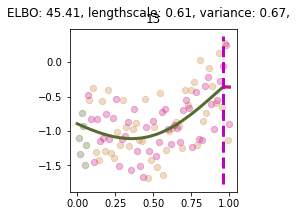

BGPs trained in 337.1 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 15 genes
Uninformative until idx: 80
MMBGP trained in 378.0 seconds


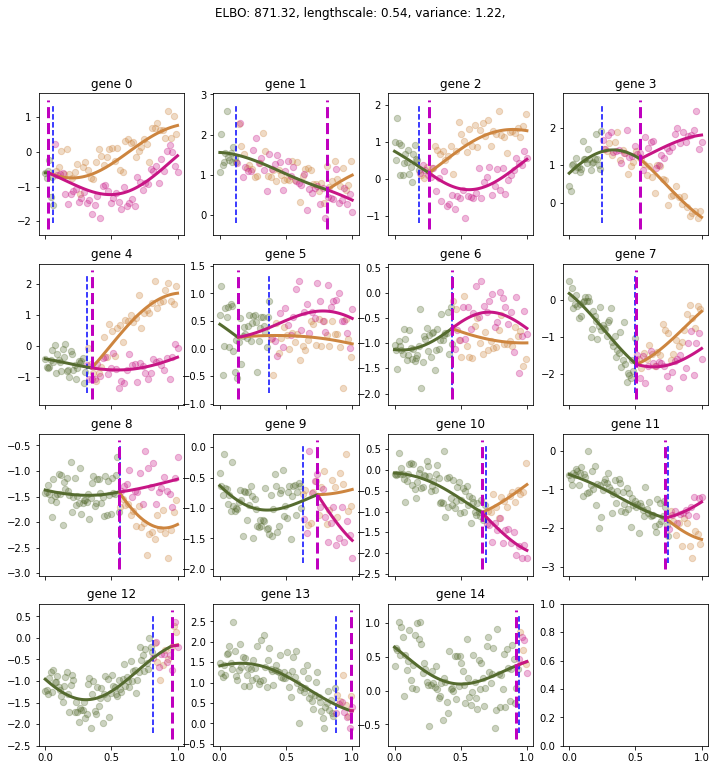

Slicing for gene 0
Uninformative until idx: 80


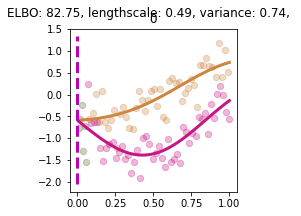

Slicing for gene 1
Uninformative until idx: 80


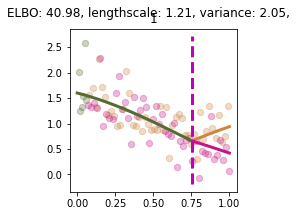

Slicing for gene 2
Uninformative until idx: 80


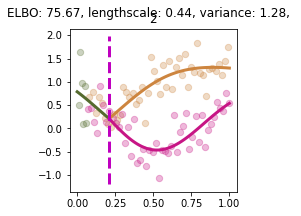

Slicing for gene 3
Uninformative until idx: 80


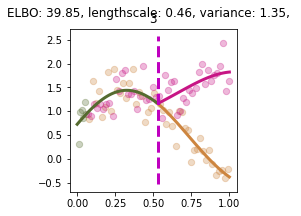

Slicing for gene 4
Uninformative until idx: 80


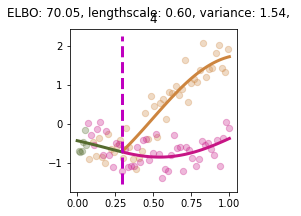

Slicing for gene 5
Uninformative until idx: 80


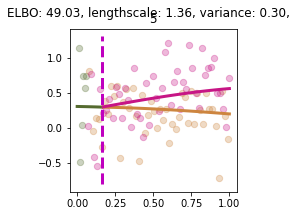

Slicing for gene 6
Uninformative until idx: 80


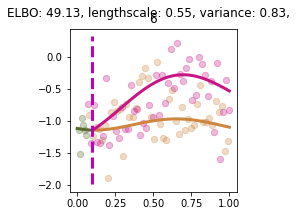

Slicing for gene 7
Uninformative until idx: 80


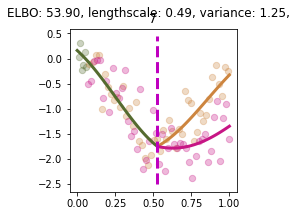

Slicing for gene 8
Uninformative until idx: 80


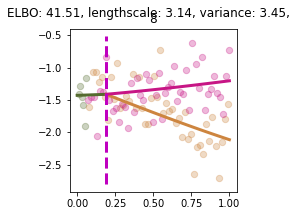

Slicing for gene 9
Uninformative until idx: 80


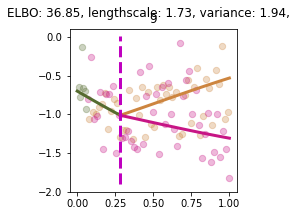

Slicing for gene 10
Uninformative until idx: 80


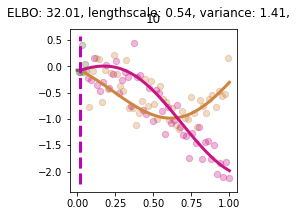

Slicing for gene 11
Uninformative until idx: 80


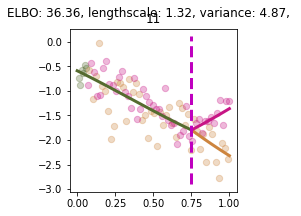

Slicing for gene 12
Uninformative until idx: 80


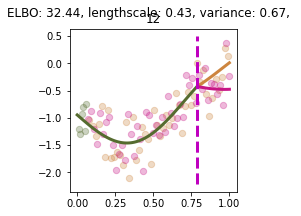

Slicing for gene 13
Uninformative until idx: 80


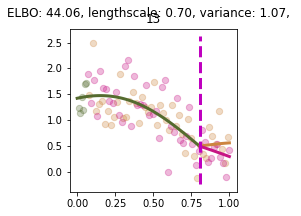

Slicing for gene 14
Uninformative until idx: 80


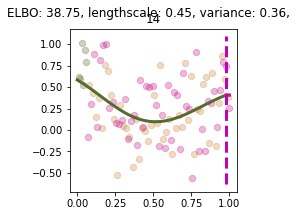

BGPs trained in 425.1 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 16 genes
Uninformative until idx: 80
MMBGP trained in 387.0 seconds


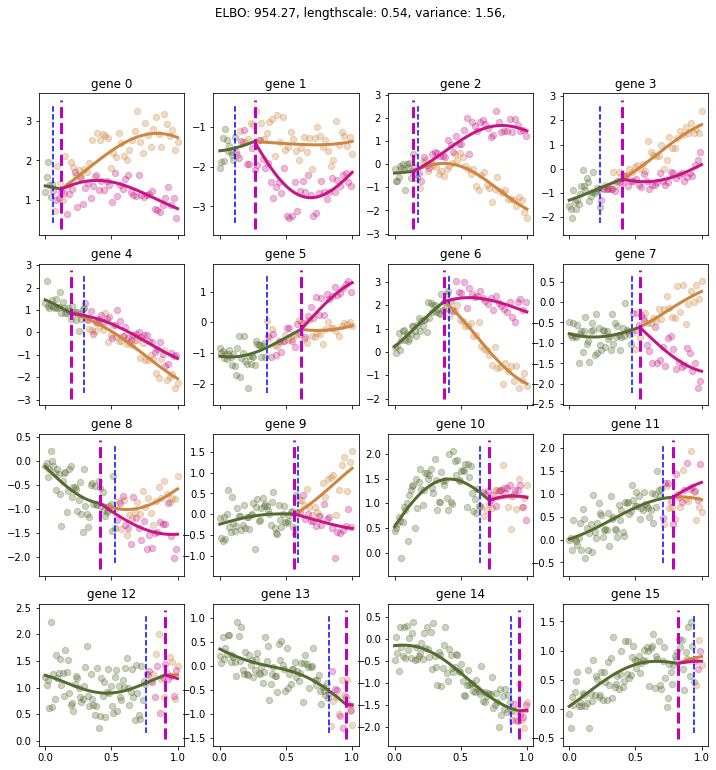

Slicing for gene 0
Uninformative until idx: 80


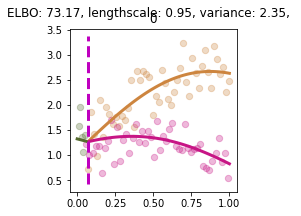

Slicing for gene 1
Uninformative until idx: 80


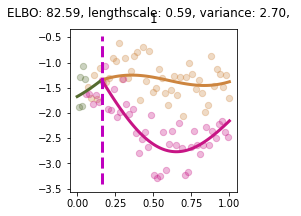

Slicing for gene 2
Uninformative until idx: 80


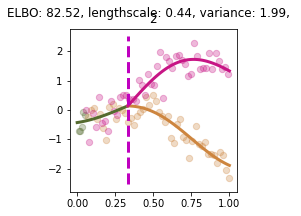

Slicing for gene 3
Uninformative until idx: 80


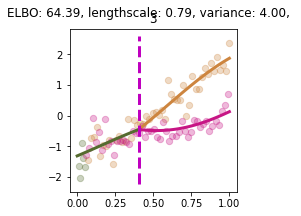

Slicing for gene 4
Uninformative until idx: 80


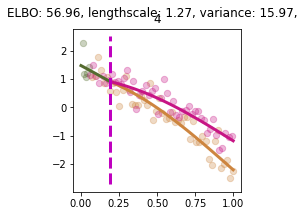

Slicing for gene 5
Uninformative until idx: 80


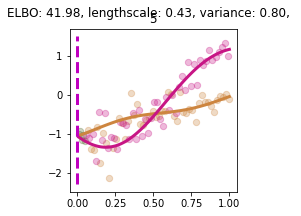

Slicing for gene 6
Uninformative until idx: 80


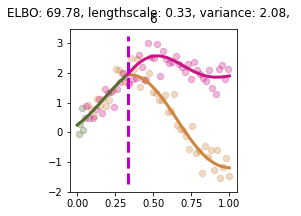

Slicing for gene 7
Uninformative until idx: 80


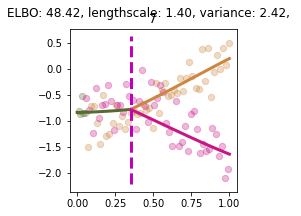

Slicing for gene 8
Uninformative until idx: 80


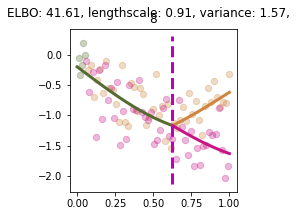

Slicing for gene 9
Uninformative until idx: 80


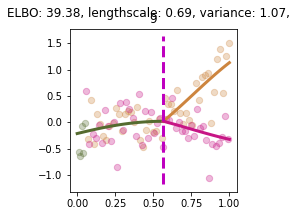

Slicing for gene 10
Uninformative until idx: 80


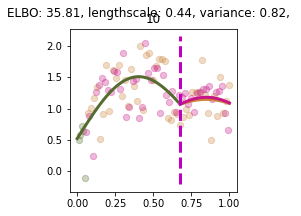

Slicing for gene 11
Uninformative until idx: 80


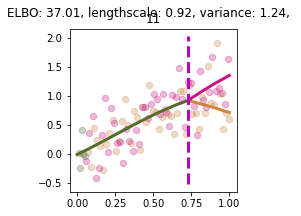

Slicing for gene 12
Uninformative until idx: 80


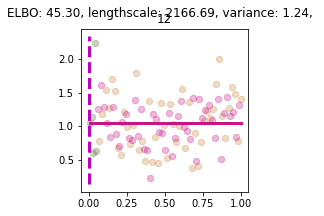

Slicing for gene 13
Uninformative until idx: 80


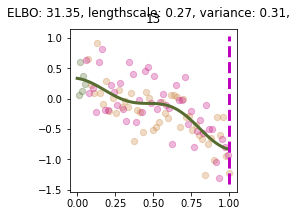

Slicing for gene 14
Uninformative until idx: 80


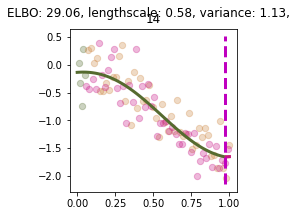

Slicing for gene 15
Uninformative until idx: 80


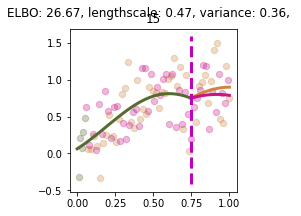

BGPs trained in 343.7 seconds
10 samples drawn, 0 valid samples constructed
Processing synthetic data for 17 genes
Uninformative until idx: 80
MMBGP trained in 469.6 seconds


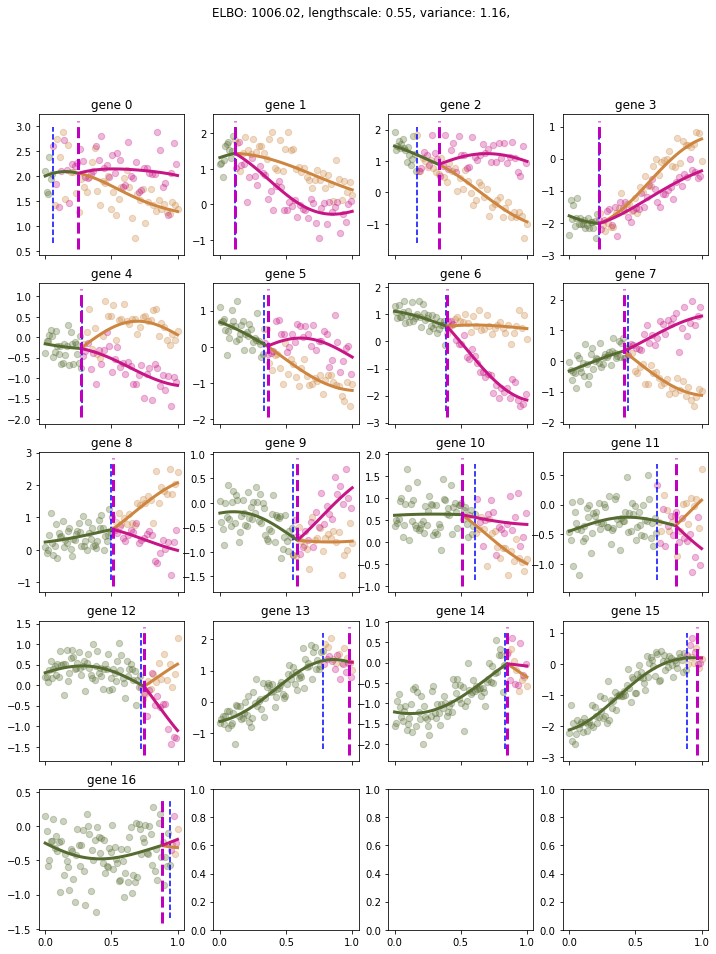

Slicing for gene 0
Uninformative until idx: 80


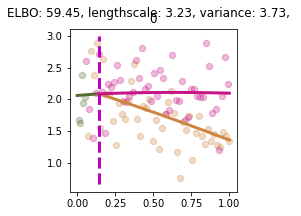

Slicing for gene 1
Uninformative until idx: 80


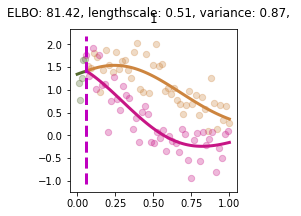

Slicing for gene 2
Uninformative until idx: 80


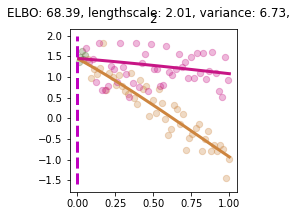

Slicing for gene 3
Uninformative until idx: 80


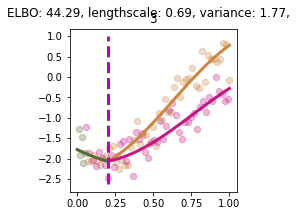

Slicing for gene 4
Uninformative until idx: 80


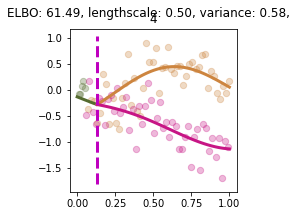

Slicing for gene 5
Uninformative until idx: 80


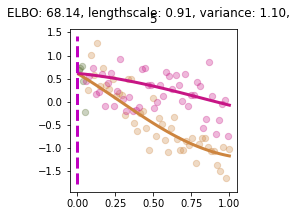

Slicing for gene 6
Uninformative until idx: 80


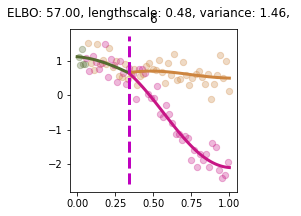

Slicing for gene 7
Uninformative until idx: 80


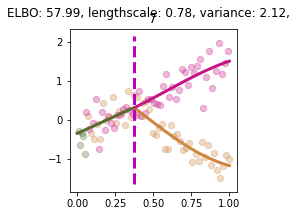

Slicing for gene 8
Uninformative until idx: 80


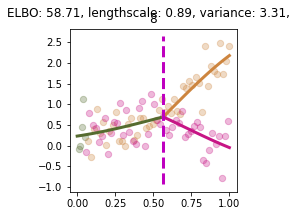

Slicing for gene 9
Uninformative until idx: 80


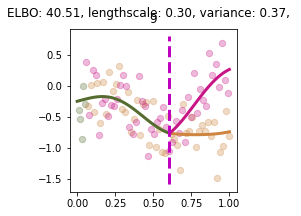

Slicing for gene 10
Uninformative until idx: 80


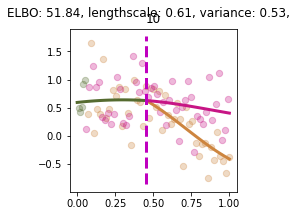

Slicing for gene 11
Uninformative until idx: 80


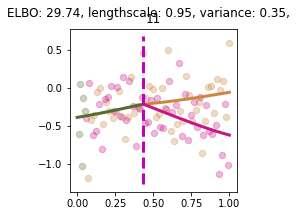

Slicing for gene 12
Uninformative until idx: 80


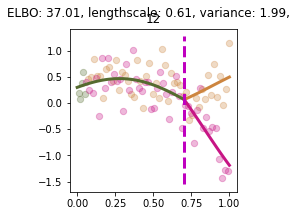

Slicing for gene 13
Uninformative until idx: 80


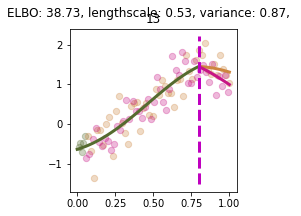

Slicing for gene 14
Uninformative until idx: 80


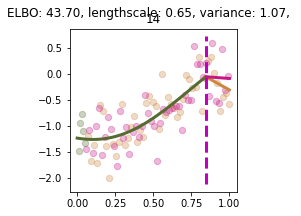

Slicing for gene 15
Uninformative until idx: 80


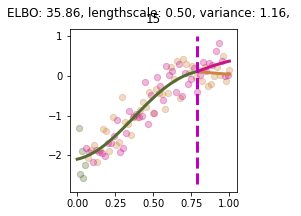

Slicing for gene 16
Uninformative until idx: 80
Error in training:  Input is not invertible.
	 [[node f2f0/invKbb (defined at /Users/elvijssarkans/dev/MMBGP/MMBGP/assigngp.py:154) ]] [Op:__inference__tf_eval_40342276]

Errors may have originated from an input operation.
Input Source operations connected to node f2f0/invKbb:
 f2f0/add_2 (defined at /Users/elvijssarkans/dev/MMBGP/MMBGP/assigngp.py:153)

Function call stack:
_tf_eval



InvalidArgumentError: Input is not invertible. [Op:MatrixInverse] name: invKbb

In [44]:
from MMBGP.training_helpers import fixed_bps
import time


NOISE = 0.1
LENGTHSCALE = 0.5
NUM_SAMPLES = 1
NUM_CELLS = 100
HIGH_PRIOR_CONFIDENCE = 0.8
LOW_PRIOR_CONFIDENCE = 0.8
UNINFORMATIVE_UNTIL = 0.8
MAX_NUM_GENES = 20
MAX_ITER = 1_000

def get_optimiser() -> AssignGPOptimiser:
    return ElvijsAmazingOptimiser(base_optimiser=ScipyOptimiser(maxiter=MAX_ITER))


results: List[Result] = []
for num_genes in range(1, MAX_NUM_GENES + 1, 1):    
    true_bps = [i/(num_genes + 1) for i in range(1, num_genes + 1, 1)]

    # Generate data
    dummy_model = get_assigngp_with_target_bps(
        true_bps, 
        lengthscale=LENGTHSCALE, 
        noise_variance=NOISE,
    )
    synthetic_noisy_data = get_synthetic_noisy_branched_data(
        dummy_model, 
        num_samples=NUM_SAMPLES, 
        x_pts=NUM_CELLS,
    )

    print(f"Processing synthetic data for {num_genes} genes")
    for i, data in enumerate(synthetic_noisy_data):
        #
        # MMBGP
        #
        st_mmbgp = time.time()
        mmbgp = construct_assigngp_model(
            gene_expression=data,
            phi_constructor=FunkyPrior(
                data,
                informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
                uninformative_until=UNINFORMATIVE_UNTIL,
            ),
            initial_branching_points=[0.5]*data.num_genes,  # Don't start at the true locations
        )
    
        optimiser = get_optimiser()
    
        try:
            trained_mmbgp = optimiser.train(mmbgp)
            et_mmbgp = time.time()
            print(f"MMBGP trained in {et_mmbgp - st_mmbgp:.1f} seconds")
        except Exception as ex:
            print(f"Error in training: {ex}")
            trained_mmbgp = mmbgp
    
        plot_model_snapshot(trained_mmbgp, genes=data, alpha=0.3)
        plt.show()
    
        #
        # BGPs
        #
        bgps = []
        st_bgps = time.time()

        for i in range(data.num_genes):
            print(f"Slicing for gene {i}")
    
            sliced_data = GeneExpressionData(
                t=data.t,
                Y=data.Y[:, i].reshape(-1, 1),
                state=data.state,
                gene_labels=[f"{i}"]
            )
   
            bgp = construct_assigngp_model(
                gene_expression=sliced_data,
                phi_constructor=FunkyPrior(
                    sliced_data,
                    informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
                    uninformative_until=UNINFORMATIVE_UNTIL,
                ),
                initial_branching_points=[0.5],  # Do not initialise to true locations
            )
    
            optimiser = get_optimiser()
        
            try:
                trained_bgp = optimiser.train(bgp)
            except Exception as ex:
                print(f"Error in training: {ex}")
                trained_bgp = bgp
            
            plot_model_snapshot(trained_bgp, genes=sliced_data, alpha=0.3)
            plt.show()
    
            bgps.append(trained_bgp)
            et_bgps = time.time()
        print(f"BGPs trained in {et_bgps - st_bgps:.1f} seconds")
    
        result = Result(
            data=data,
            true_bps=np.array(true_bps),
            mmbgp=trained_mmbgp,
            bgps=bgps,
            time_mmbgp_s=et_mmbgp - st_mmbgp,
            time_bgps_s=et_bgps - st_bgps, 
        )
        results.append(result)

In [45]:
df2 = convert_results_to_df(results)
df2.head(30)

,sample_id,time_mmbgp_s,mmbgp_bp_rmse,time_bgps_s,bgp_bp_rmse
0,0,21.726989,0.007953,17.915702,0.065657
1,1,36.744995,0.080992,43.629129,0.453844
2,2,50.656940,0.100327,60.497159,0.316603
3,3,66.839932,0.310800,90.597356,0.299091
4,4,99.480320,0.369849,110.150327,0.306901
5,5,-111.566054,0.556259,119.386848,0.396038
6,6,127.088150,0.116118,149.966647,0.148069
7,7,157.007227,0.184555,197.884399,0.128233
8,8,188.423353,0.314163,211.425301,0.193421
9,9,191.477718,0.205876,262.628024,0.160605


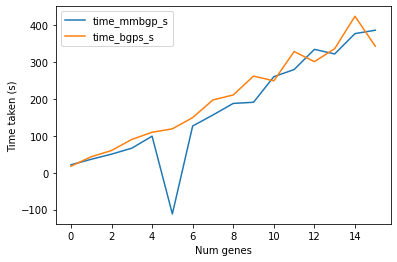

In [46]:
fig, ax = plt.subplots()

for col in ['time_mmbgp_s', 'time_bgps_s']:
    ax.plot(df2["sample_id"], df2[col], label=col)

ax.set_ylabel("Time taken (s)")
ax.set_xlabel("Num genes")

ax.legend(loc="best")
    
plt.show()